In [ ]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
import numpy as np
import cv2
import pickle
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.gridspec as gridspec

In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


**Camera Calibration**

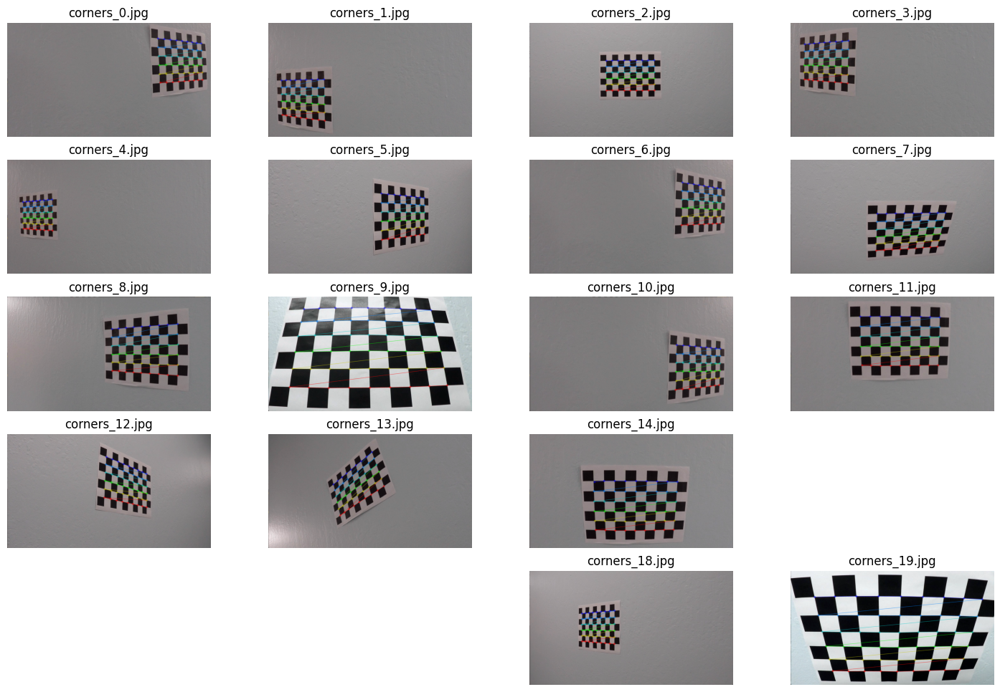

In [ ]:
CHECKERBOARD = (6,9)
objp = np.zeros((CHECKERBOARD[0]*CHECKERBOARD[1],3), np.float32)
objp[:,:2] = np.mgrid[0:CHECKERBOARD[1], 0: CHECKERBOARD[0]].T.reshape(-1,2)
objpoints = []
imgpoints = []

images = glob.glob("/content/gdrive/MyDrive/CV Project Data/camera_calib_data/calibration*.jpg")

plt.figure(figsize = (18,12))
grid = gridspec.GridSpec(5,4)
count = 0
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (CHECKERBOARD[1], CHECKERBOARD[0]), None)
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        img = cv2.drawChessboardCorners(img, (CHECKERBOARD[1], CHECKERBOARD[0]), corners, ret)
        write_file_name = 'corners_' + str(idx) + '.jpg'
        img_plt = plt.subplot(grid[count])
        plt.axis('on')
        img_plt.set_xticklabels([])
        img_plt.set_yticklabels([])
        #img_plt.set_aspect('equal')
        plt.imshow(img)
        plt.title(write_file_name)
        plt.axis('off')
    count+=1
plt.show()

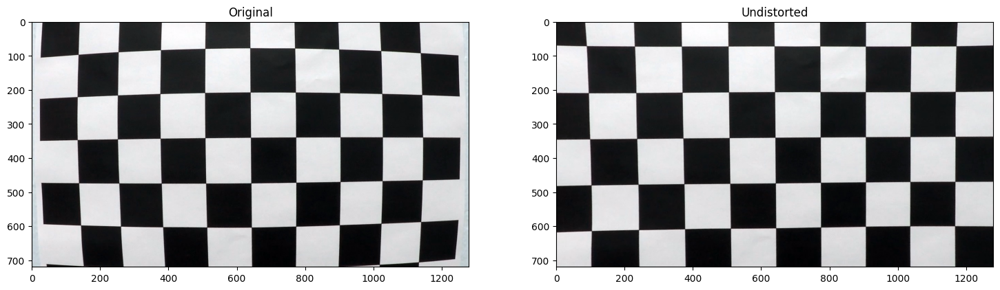

In [ ]:
image = cv2.imread("/content/gdrive/MyDrive/CV Project Data/camera_calib_data/calibration1.jpg")
img_size = (image.shape[1], image.shape[0])

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

calib_pickle = {}
calib_pickle["matrix"] = mtx
calib_pickle["distortion"] = dist
pickle.dump(calib_pickle, open("calibration_pickle.p", "wb"))

undistorted = cv2.undistort(image, mtx, dist, None, mtx)
plt.figure(figsize = (18,12))
grid = gridspec.GridSpec(1,2)

plot_idx = plt.subplot(grid[0])
plt.imshow(image)
plt.title("Original")
plot_idx = plt.subplot(grid[1])
plt.imshow(undistorted)
plt.title("Undistorted")
plt.show()

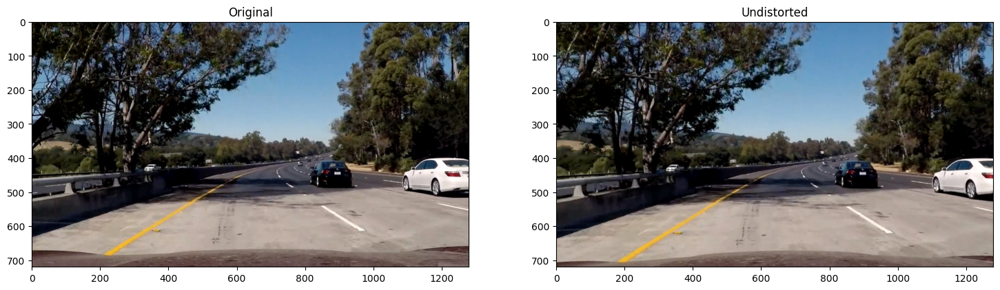

In [ ]:
carImg = cv2.imread("/content/gdrive/MyDrive/CV Project Data/test_images/test5.jpg")
carImg = cv2.cvtColor(carImg, cv2.COLOR_BGR2RGB)

undistorted = cv2.undistort(carImg, mtx, dist, None, mtx)

plt.figure(figsize = (18,12))
grid = gridspec.GridSpec(1,2)

plot_idx = plt.subplot(grid[0])
plt.imshow(carImg)
plt.title("Original")
plot_idx = plt.subplot(grid[1])
plt.imshow(undistorted)
plt.title("Undistorted")
plt.show()

**Preprocessing**

In [ ]:
def color_threshold(image, sthresh=(0,255), vthresh=(0,255)):
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel > sthresh[0]) & (s_channel <= sthresh[1])] = 1

    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    v_channel = hsv[:,:,2]
    v_binary = np.zeros_like(v_channel)
    v_binary[(v_channel > vthresh[0]) & (v_channel <= vthresh[1])] = 1

    output = np.zeros_like(s_channel)
    output[(s_binary == 1) & (v_binary) == 1] = 1

    # Return the combined s_channel & v_channel binary image
    return output

def window_mask(width, height, img_ref, center, level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height), max(0,int(center-width)):min(int(center+width),img_ref.shape[1])] = 1
    return output

### **Sparsh Checkout these functions**

In [ ]:
import scipy.signal
import scipy.fft
from scipy import ndimage, misc

In [ ]:
def zerocrosshelper(logimg, i, j,threshx,threshy):
  if(logimg[i-1][j]*logimg[i+1][j]<0 and np.abs(logimg[i-1][j]-logimg[i+1][j])>threshx):
      return 1
  if(logimg[i][j-1]*logimg[i][j+1]<0 and np.abs(logimg[i][j-1]-logimg[i][j+1])>threshy):
      return 1
  if(logimg[i-1][j-1]*logimg[i+1][j+1]<0 and np.abs(logimg[i-1][j-1]-logimg[i+1][j+1])>threshx):
      return 1
  if(logimg[i-1][j+1]*logimg[i+1][j-1]<0 and np.abs(logimg[i-1][j+1]-logimg[i+1][j-1])>threshx):
      return 1
  return 0

def zeroCrossing(img):
  hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
  l_channel = hls[:,:,1]
  height = l_channel.shape[0]
  width = l_channel.shape[1]
  print(l_channel.shape)
  box_filter= np.ones((3,3),dtype=float)
  box_filter = box_filter/9
  blurred_img = scipy.signal.convolve2d(l_channel, box_filter)
  blurred_img = blurred_img[:height, :width]
  result = ndimage.gaussian_laplace(blurred_img, sigma=2)
  zc = np.zeros((height,width))
  mean = np.mean(np.abs(result))
  threshx = 0.2*np.max(result)
  threshy = 0.35*np.max(result)

  for i in range(1,height-1):
    for j in range(1,width-1):
        zc[i][j] = zerocrosshelper(result, i, j,threshx,threshy)
  zc = np.float32(zc)
  median = cv2.medianBlur(zc, 5)
  return median

def sobelxFFT(img,thresh_min=20, thresh_max=100):
  hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
  l_channel = hls[:,:,1]
  kernel=np.array([[-1,0,1],[-2,0,2],[-1,0,1]])
  fftkernel = scipy.fft.fft2(kernel,(l_channel.shape[0]+kernel.shape[0]-1, l_channel.shape[1]++kernel.shape[1]-1))
  fftkernel = scipy.fft.fftshift(fftkernel)
  fftl_channel = scipy.fft.fft2(l_channel,(l_channel.shape[0]+kernel.shape[0]-1, l_channel.shape[1]++kernel.shape[1]-1))
  fftl_channel = scipy.fft.fftshift(fftl_channel)
  result = fftl_channel*fftkernel
  result = scipy.fft.ifftshift(result)
  result = scipy.fft.ifft2(result)
  result = result[:l_channel.shape[0], :l_channel.shape[1]]
  result = result.real
  result = np.abs(result)
  result = np.uint8(255*result/np.max(result))
  binary_output = np.zeros_like(result)
  binary_output[(result >= thresh_min) & (result <= thresh_max)] = 1

  return binary_output

def sobelyFFT(img,thresh_min=20, thresh_max=100):
  hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
  l_channel = hls[:,:,1]
  kernel=np.array([[1,2,1],[0,0,0],[-1,-2,-1]])
  fftkernel = scipy.fft.fft2(kernel,(l_channel.shape[0]+kernel.shape[0]-1, l_channel.shape[1]++kernel.shape[1]-1))
  fftkernel = scipy.fft.fftshift(fftkernel)
  fftl_channel = scipy.fft.fft2(l_channel,(l_channel.shape[0]+kernel.shape[0]-1, l_channel.shape[1]++kernel.shape[1]-1))
  fftl_channel = scipy.fft.fftshift(fftl_channel)
  result = fftl_channel*fftkernel
  result = scipy.fft.ifftshift(result)
  result = scipy.fft.ifft2(result)
  result = result[:l_channel.shape[0], :l_channel.shape[1]]
  result = result.real
  result = np.abs(result)
  result = np.uint8(255*result/np.max(result))
  binary_output = np.zeros_like(result)
  binary_output[(result >= thresh_min) & (result <= thresh_max)] = 1
  return binary_output

def laplacianFFT(img,thresh_min=20, thresh_max=255):
  hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
  l_channel = hls[:,:,1]
  kernel=np.array([[-1,-1,-1],[-1,8,-1],[-1,-1,-1]])
  # kernel=np.array([[0,-1,0],[-1,4,-1],[0,-1,0]])
  fftkernel = scipy.fft.fft2(kernel,(l_channel.shape[0]+kernel.shape[0]-1, l_channel.shape[1]++kernel.shape[1]-1))
  fftkernel = scipy.fft.fftshift(fftkernel)
  fftl_channel = scipy.fft.fft2(l_channel,(l_channel.shape[0]+kernel.shape[0]-1, l_channel.shape[1]++kernel.shape[1]-1))
  fftl_channel = scipy.fft.fftshift(fftl_channel)
  result = fftl_channel*fftkernel
  result = scipy.fft.ifftshift(result)
  result = scipy.fft.ifft2(result)
  result = result[:l_channel.shape[0], :l_channel.shape[1]]
  result = result.real
  result = np.abs(result)
  result = np.uint8(255*result/np.max(result))
  binary_output = np.zeros_like(result)
  binary_output = cv2.medianBlur(binary_output,3)
  binary_output[(result >= thresh_min) & (result <= thresh_max)] = 1
  return binary_output

def laplacianGaussianFFT(img,thresh_min=25, thresh_max=255):
  hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
  l_channel = hls[:,:,1]
  kernel=np.array([[0,0,-1,0,0],[0,-1,-2,-1,0],[-1,-2,16,-2,-1],[0,-1,-2,-1,0],[0,0,-1,0,0]])
  fftkernel = scipy.fft.fft2(kernel,(l_channel.shape[0]+kernel.shape[0]-1, l_channel.shape[1]++kernel.shape[1]-1))
  fftkernel = scipy.fft.fftshift(fftkernel)
  fftl_channel = scipy.fft.fft2(l_channel,(l_channel.shape[0]+kernel.shape[0]-1, l_channel.shape[1]++kernel.shape[1]-1))
  fftl_channel = scipy.fft.fftshift(fftl_channel)
  result = fftl_channel*fftkernel
  result = scipy.fft.ifftshift(result)
  result = scipy.fft.ifft2(result)
  result = result[:l_channel.shape[0], :l_channel.shape[1]]
  result = result.real
  result = np.abs(result)
  result = np.uint8(255*result/np.max(result))
  binary_output = np.zeros_like(result)
  binary_output = cv2.medianBlur(binary_output,3)
  binary_output[(result >= thresh_min) & (result <= thresh_max)] = 1
  return binary_output

def preprocessSobel(img):
  prepImg = np.zeros_like(img[:,:,0])
  imgx = sobelxFFT(img,thresh_min=15, thresh_max=255)
  imgy = sobelxFFT(img,thresh_min=25, thresh_max=255)
  c_img = color_threshold(img, sthresh=(90,255), vthresh=(60,255))
  prepImg[((imgx == 1) & (imgy ==1) | (c_img == 1))] = 255
  return prepImg

def preprocessZeroCrossing(img):
  prepImg = np.zeros_like(img[:,:,0])
  zcImg = zeroCrossing(img)
  c_img = color_threshold(img, sthresh=(100,255), vthresh=(50,255))
  prepImg[((zcImg==1) | (c_img == 1))] = 255
  return prepImg

def preprocessLoG(img):
  prepImg = np.zeros_like(img[:,:,0])
  logImg = laplacianGaussianFFT(img)
  c_img = color_threshold(img, sthresh=(100,255), vthresh=(50,255))
  prepImg[((logImg ==1) | (c_img == 1))] = 255
  return prepImg

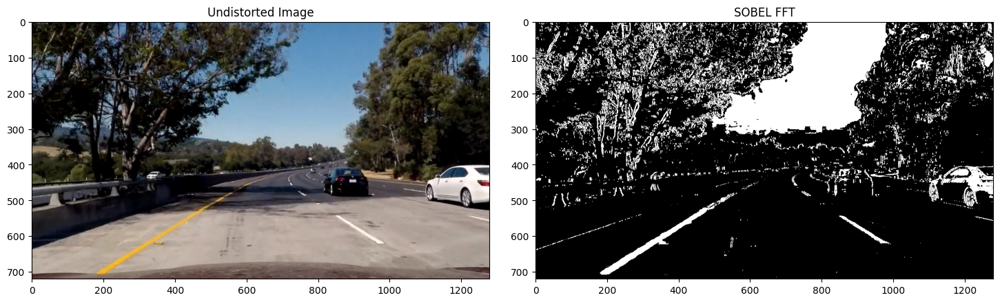

In [ ]:
#Apply Sobel operator in X-direction to experiment with gradient thresholds
carImg = cv2.imread("/content/gdrive/MyDrive/CV Project Data/test_images/test5.jpg")
carImg = cv2.cvtColor(carImg, cv2.COLOR_BGR2RGB)
undistorted = cv2.undistort(carImg, mtx, dist, None, mtx)

procressed_image = preprocessSobel(undistorted)

#Visualize the results before/after absolute sobel operator is applied on a test image in x direction to find the
#vertical lines, since the lane lines are close to being vertical
plt.figure(figsize = (18,12))
grid = gridspec.GridSpec(1,2)

# set the spacing between axes.
grid.update(wspace=0.1, hspace=0.1)  

plt.subplot(grid[0])
plt.imshow(undistorted, cmap="gray")
plt.title('Undistorted Image')

plt.subplot(grid[1])
plt.imshow(procressed_image, cmap="gray")
plt.title('SOBEL FFT')

plt.show()

(720, 1280)


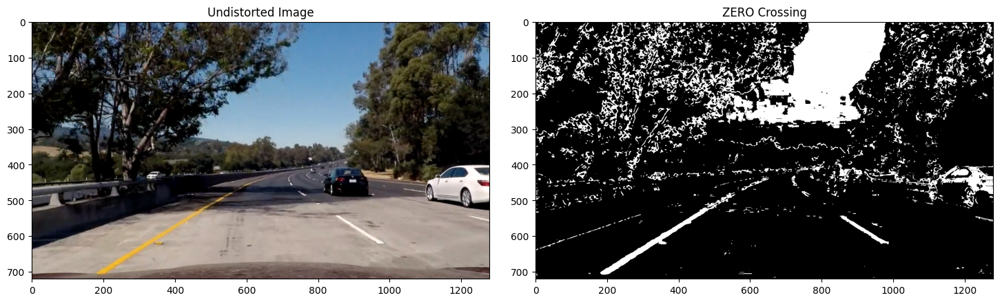

In [ ]:
#Apply Sobel operator in X-direction to experiment with gradient thresholds
carImg = cv2.imread("/content/gdrive/MyDrive/CV Project Data/test_images/test5.jpg")
carImg = cv2.cvtColor(carImg, cv2.COLOR_BGR2RGB)
undistorted = cv2.undistort(carImg, mtx, dist, None, mtx)

procressed_image = preprocessZeroCrossing(undistorted)

#Visualize the results before/after absolute sobel operator is applied on a test image in x direction to find the
#vertical lines, since the lane lines are close to being vertical
plt.figure(figsize = (18,12))
grid = gridspec.GridSpec(1,2)

# set the spacing between axes.
grid.update(wspace=0.1, hspace=0.1)  

plt.subplot(grid[0])
plt.imshow(undistorted, cmap="gray")
plt.title('Undistorted Image')

plt.subplot(grid[1])
plt.imshow(procressed_image, cmap="gray")
plt.title('ZERO Crossing')

plt.show()

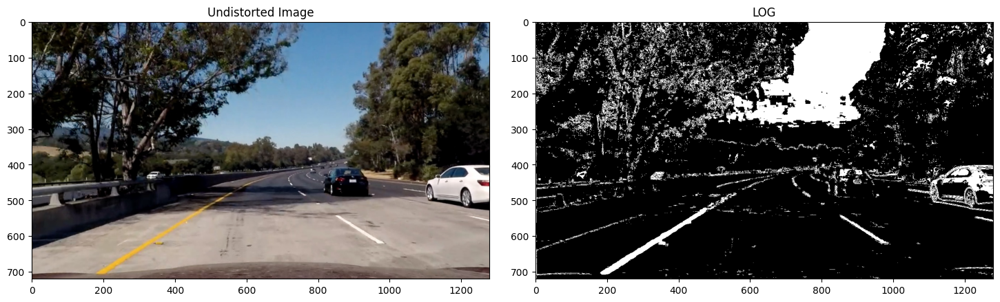

In [ ]:
#Apply Sobel operator in X-direction to experiment with gradient thresholds
carImg = cv2.imread("/content/gdrive/MyDrive/CV Project Data/test_images/test5.jpg")
carImg = cv2.cvtColor(carImg, cv2.COLOR_BGR2RGB)
undistorted = cv2.undistort(carImg, mtx, dist, None, mtx)

procressed_image = preprocessLoG(undistorted)

#Visualize the results before/after absolute sobel operator is applied on a test image in x direction to find the
#vertical lines, since the lane lines are close to being vertical
plt.figure(figsize = (18,12))
grid = gridspec.GridSpec(1,2)

# set the spacing between axes.
grid.update(wspace=0.1, hspace=0.1)  

plt.subplot(grid[0])
plt.imshow(undistorted, cmap="gray")
plt.title('Undistorted Image')

plt.subplot(grid[1])
plt.imshow(procressed_image, cmap="gray")
plt.title('LOG')

plt.show()

(720, 1280)
(1280, 720)
(720, 1280)
(1280, 720)
(720, 1280)
(1280, 720)
(720, 1280)
(1280, 720)
(720, 1280)
(1280, 720)
(720, 1280)
(1280, 720)
(720, 1280)
(1280, 720)
(720, 1280)
(1280, 720)


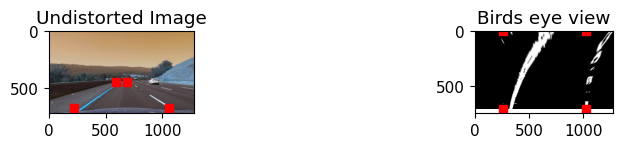

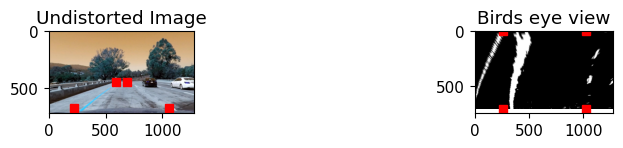

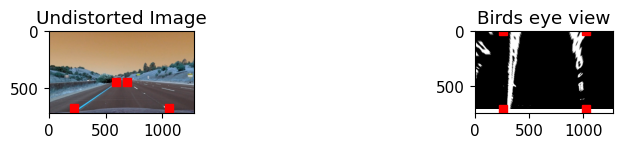

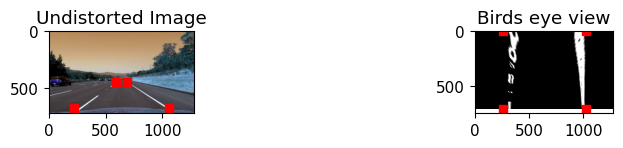

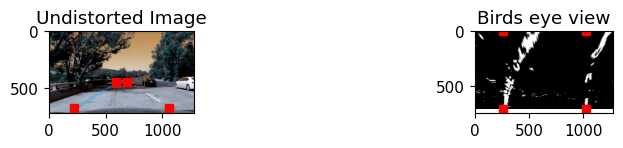

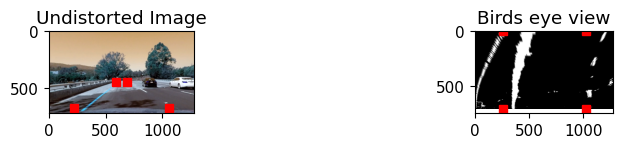

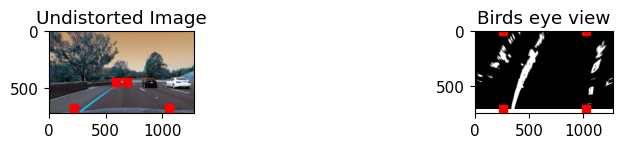

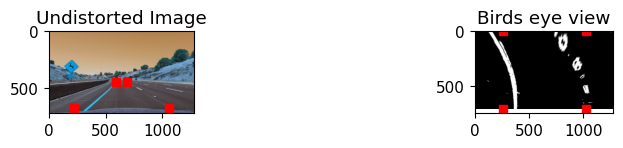

In [ ]:
images = glob.glob('/content/gdrive/MyDrive/CV Project Data/test_images/*.jpg')
gidx = 0
for idx,fname in enumerate(images):
    img_size = (img.shape[1],img.shape[0])
    #read in image
    img = cv2.imread(fname)
    #undistort the image
    newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, img_size, 0, img_size)
    img = cv2.undistort(img,newcameramtx,dist,None,newcameramtx)
    
    #pass image thru the pipeline
    preprocessImage = preprocessZeroCrossing(img)
    
    print(img_size)

    #parameter tuning karni hogi ispe 
    bot_width = .65
    top_width = .08
    height_pct = .62 
    bottom_trim= .93


    src = np.float32([[img.shape[1]*(0.5-top_width/2), img.shape[0]*height_pct],[img.shape[1]*(0.5+top_width/2),img.shape[0]*height_pct],[img.shape[1]*(0.5+bot_width/2), img.shape[0]*bottom_trim],[img.shape[1]*(0.5-bot_width/2), img.shape[0]*bottom_trim]])
    offset = img_size[0]*0.2
    dst = np.float32([[offset,0],[img_size[0]-offset,0],[img_size[0]-offset,img_size[1]],[offset,img_size[1]]])
    
    #homography with 4 points
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    warped = cv2.warpPerspective(preprocessImage,M,img_size,flags=cv2.INTER_LINEAR)

    plt.figure(figsize = (10,10))
    grid = gridspec.GridSpec(8,2)

    plt.subplot(grid[gidx])
    plt.imshow(img, cmap="gray")
    for i in range(4):
        plt.plot(src[i][0],src[i][1],'rs')
    plt.title('Undistorted Image')

    plt.subplot(grid[gidx+1])
    plt.imshow(warped, cmap="gray")
    for i in range(4):
        plt.plot(dst[i][0],dst[i][1],'rs')
    plt.title('Birds eye view')
    write_name='/content/gdrive/MyDrive/CV Project Data/plots/ZERO_CROSSING/'+str(idx)+'.jpg'
    write_name2='/content/gdrive/MyDrive/CV Project Data/plots/ZERO_CROSSING/undistored'+str(idx)+'.jpg'

    cv2.imwrite(write_name, warped)
    cv2.imwrite(write_name2, img)
plt.show()

In [ ]:
class tracker():
    def __init__(self, window_width, window_height, margin, ym = 1, xm = 1, smoothing = 15):
        self.centers = []
        self.window_width = window_width
        self.window_height = window_height
        self.margin = margin
        self.ym = ym 
        self.xm = xm
        self.smoothing = smoothing
    
    def findCentroid(self, warped):
        window_width = self.window_width
        window_height = self.window_height
        margin = self.margin 

        centroids = []
        conv_window = np.ones(window_width)
        # print(conv_window.shape)
        left_sum = np.sum(warped[int(3*warped.shape[0]/4):,:int(warped.shape[1]/2)], axis = 0)
        # print(left_sum.shape)
        print(np.argmax(np.convolve(conv_window, left_sum)))
        left_center = np.argmax(np.convolve(conv_window, left_sum)) - window_width/2
        right_sum = np.sum(warped[int(3*warped.shape[0]/4):, int(warped.shape[1]/2):],axis = 0)
        right_center = np.argmax(np.convolve(conv_window, right_sum)) - window_width/2 + int(warped.shape[1]/2)

        centroids.append((left_center, right_center))

        for level in range(1,(int)(warped.shape[0]/window_height)):
            img_layer = np.sum(warped[int(warped.shape[0]-(level+1)*window_height):int(warped.shape[0]-level*window_height), :], axis = 0)
            conv_signal = np.convolve(conv_window, img_layer)
            offset = window_width/2
            left_min_index = int(max(left_center + offset - margin, 0))
            left_max_index = int(min(left_center + offset + margin, warped.shape[1]))
            left_center = np.argmax(conv_signal[left_min_index: left_max_index]) + left_min_index - offset
            right_min_index = int(max(right_center + offset - margin,0))
            right_max_index = int(min(right_center + offset + margin, warped.shape[1]))
            right_center = np.argmax(conv_signal[right_min_index:right_max_index]) + right_min_index - offset
            centroids.append((left_center, right_center))
        self.centers.append(centroids)

        return np.average(self.centers[-self.smoothing:], axis = 0)


(720, 1280)
(1280, 720)
(720, 1280)
378


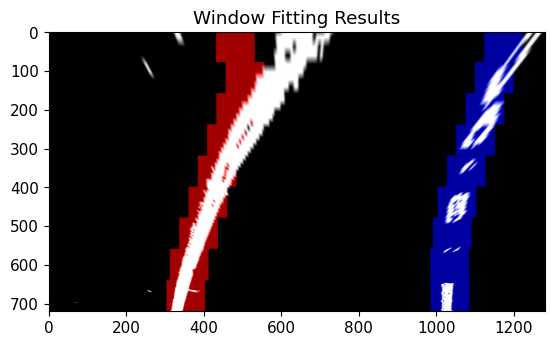

(720, 1280)
(1280, 720)
(720, 1280)
366


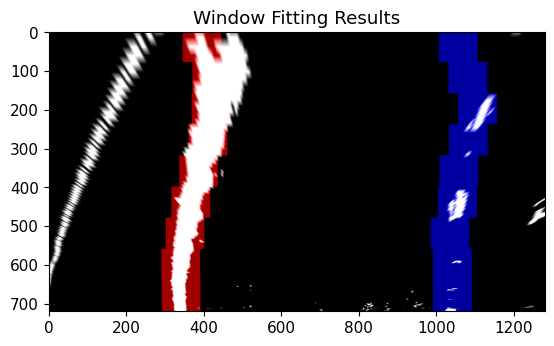

(720, 1280)
(1280, 720)
(720, 1280)
346


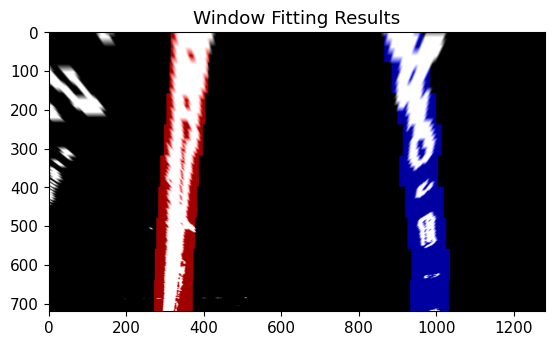

(720, 1280)
(1280, 720)
(720, 1280)
345


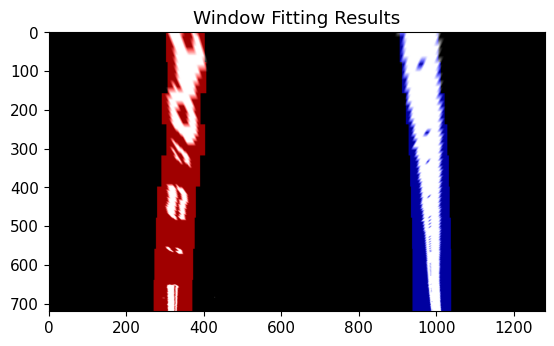

(720, 1280)
(1280, 720)
(720, 1280)
313


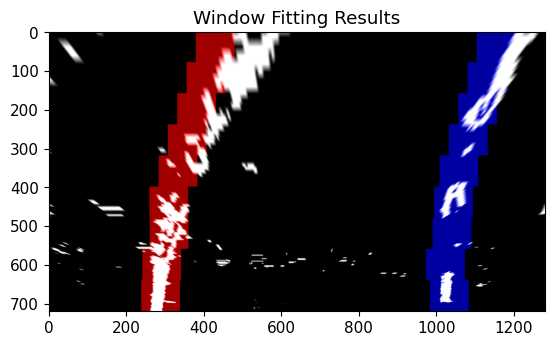

(720, 1280)
(1280, 720)
(720, 1280)
388


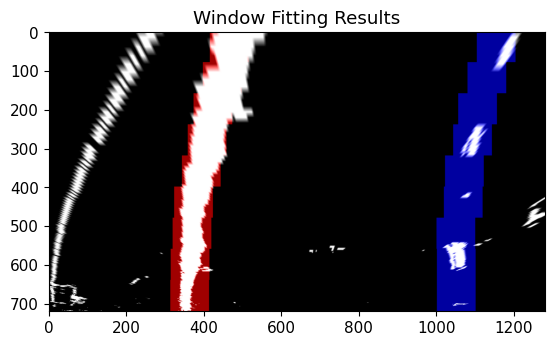

(720, 1280)
(1280, 720)
(720, 1280)
394


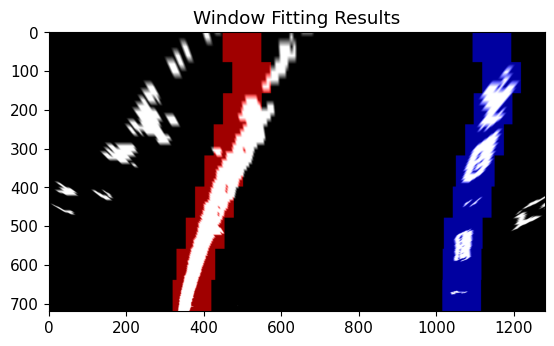

(720, 1280)
(1280, 720)
(720, 1280)
395


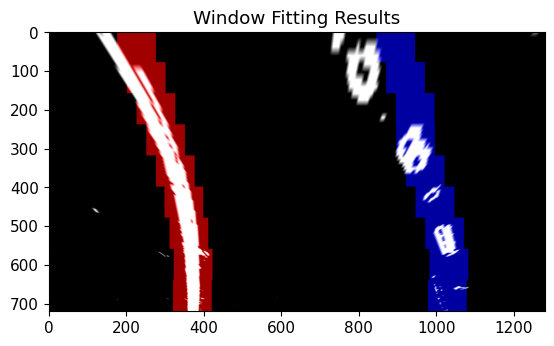

In [ ]:
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    # img = cv2.undistort(img,mtx,dist,None,mtx)
    newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, img_size, 0, img_size)
    img = cv2.undistort(img,newcameramtx,dist,None,newcameramtx)

    preprocessImage = preprocessZeroCrossing(img)

    # preprocessImage = np.zeros_like(img[:,:,0])
    # gradx = abs_sobel_thresh(img, orient='x', thresh_min=12, thresh_max=255)
    # grady = abs_sobel_thresh(img, orient='y', thresh_min=25, thresh_max=255)
    # c_binary = color_threshold(img, sthresh=(100,255), vthresh=(50,255))
    # preprocessImage[((gradx == 1) & (grady ==1) | (c_binary == 1))] = 255
    
    img_size = (img.shape[1],img.shape[0])
    print(img_size)

    #parameter tuning karni hogi ispe 
    bot_width = .65
    top_width = .08
    height_pct = .62 
    bottom_trim= .93


    src = np.float32([[img.shape[1]*(0.5-top_width/2), img.shape[0]*height_pct],[img.shape[1]*(0.5+top_width/2),img.shape[0]*height_pct],[img.shape[1]*(0.5+bot_width/2), img.shape[0]*bottom_trim],[img.shape[1]*(0.5-bot_width/2), img.shape[0]*bottom_trim]])
    offset = img_size[0]*0.2
    dst = np.float32([[offset,0],[img_size[0]-offset,0],[img_size[0]-offset,img_size[1]],[offset,img_size[1]]])
    
    #homography with 4 points
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    warped = cv2.warpPerspective(preprocessImage,M,img_size,flags=cv2.INTER_LINEAR)
    print(warped.shape)
    width = 50
    height = 80

    curve_centers = tracker(width, height, 25, 10/720, 4/384, 15)
    centroids = curve_centers.findCentroid(warped)

    left_points = np.zeros_like(warped)
    right_points = np.zeros_like(warped)

    rightlane = []
    leftlane = []

    for level in range(0, len(centroids)):
        leftlane.append(centroids[level][0])
        rightlane.append(centroids[level][1])

        left_mask = window_mask(width, height,warped,centroids[level][0], level)
        right_mask = window_mask(width, height,warped,centroids[level][1],level)

        left_points[(left_points == 255) | ((left_mask == 1))] = 200
        right_points[(right_points == 255) | ((right_mask == 1))] = 200

    left_windows = np.array(left_points, np.uint8)
    right_windows = np.array(right_points, np.uint8)
    zero_channel = np.zeros_like(left_points)
    leftist = np.array(cv2.merge((left_windows,zero_channel, zero_channel)), np.uint8)
    rightist = np.array(cv2.merge((zero_channel, zero_channel, right_windows)), np.uint8)
    warpage = np.array(cv2.merge((warped,warped,warped)), np.uint8)
    result = cv2.addWeighted(warpage, 1, leftist, 0.8, 0.0)
    result = cv2.addWeighted(result, 1, rightist, 0.8, 0.0)

    plt.imshow(result, cmap = 'gray')
    plt.title('Window Fitting Results')
    write_name='/content/gdrive/MyDrive/CV Project Data/plots/ZERO_CROSSING/WindowFitting'+str(idx)+'.jpg'
    # write_name2='/content/gdrive/MyDrive/CV Project Data/plots/SOBEL/undistored'+str(idx)+'.jpg'

    cv2.imwrite(write_name, result)
    # cv2.imwrite(write_name2, img)
    plt.show()


(720, 1280)
378
[-0.00016098    -0.13076      505.03]
(720, 1280)
366
[ -0.0001921   0.0062284      411.63]
(720, 1280)
346
[  4.143e-05    -0.10337      370.63]
(720, 1280)
345
[-2.8409e-05   -0.038712       356.5]
(720, 1280)
313
[ 0.00024317    -0.40341      448.12]
(720, 1280)
388
[ 0.00023471    -0.33566      480.96]
(720, 1280)
394
[-0.00016572    -0.12818       521.8]
(720, 1280)
395
[-0.00027056     0.43564      204.33]


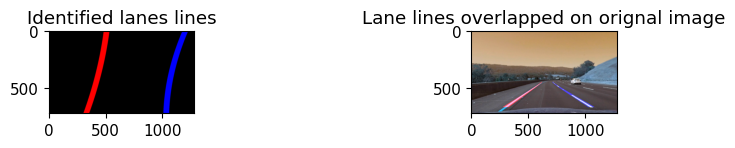

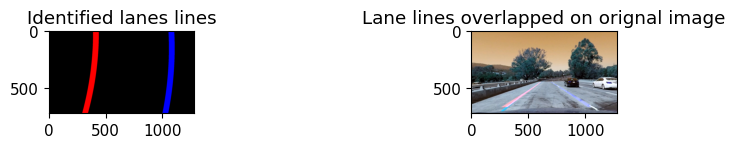

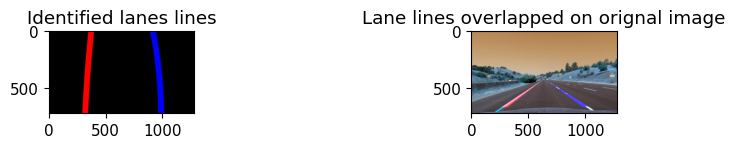

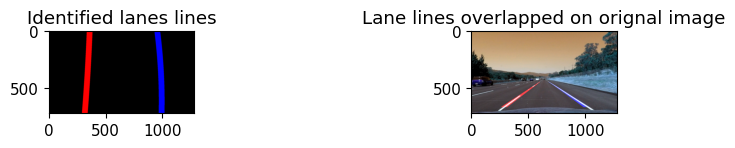

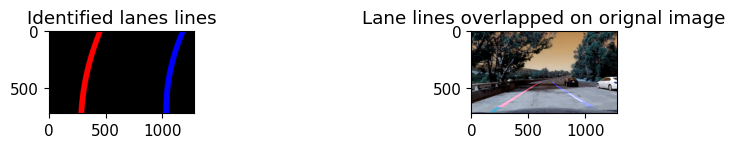

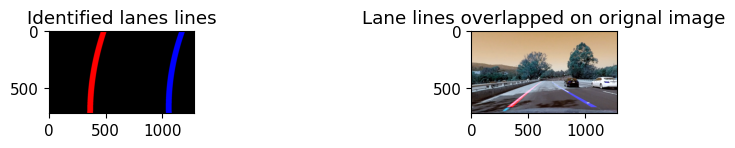

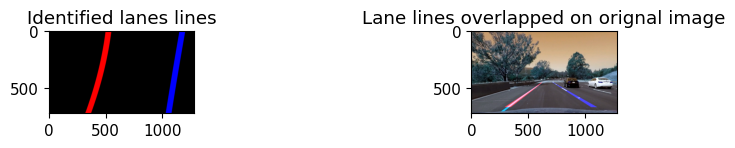

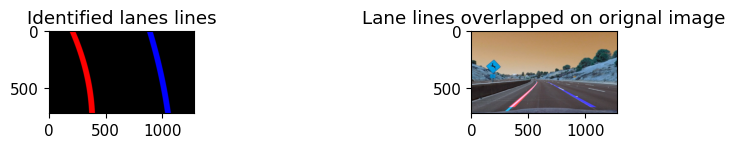

In [ ]:
gidx = 0

for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    #undistort the image
    newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, img_size, 0, img_size)
    img = cv2.undistort(img,newcameramtx,dist,None,newcameramtx)
    
    #pass image thru the pipeline
    preprocessImage = preprocessZeroCrossing(img)

    #parameter tuning karni hogi ispe 
    bot_width = .65
    top_width = .08
    height_pct = .62 
    bottom_trim= .93


    src = np.float32([[img.shape[1]*(0.5-top_width/2), img.shape[0]*height_pct],[img.shape[1]*(0.5+top_width/2),img.shape[0]*height_pct],[img.shape[1]*(0.5+bot_width/2), img.shape[0]*bottom_trim],[img.shape[1]*(0.5-bot_width/2), img.shape[0]*bottom_trim]])
    offset = img_size[0]*0.2
    dst = np.float32([[offset,0],[img_size[0]-offset,0],[img_size[0]-offset,img_size[1]],[offset,img_size[1]]])
    
    #homography with 4 points
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    warped = cv2.warpPerspective(preprocessImage,M,img_size,flags=cv2.INTER_LINEAR)
    # print(warped.shape)
    width = 50
    height = 80

    curve_centers = tracker(width, height, 25, 10/720, 4/384, 15)
    centroids = curve_centers.findCentroid(warped)

    left_points = np.zeros_like(warped)
    right_points = np.zeros_like(warped)

    rightlane = []
    leftlane = []

    for level in range(0, len(centroids)):
        leftlane.append(centroids[level][0])
        rightlane.append(centroids[level][1])

        left_mask = window_mask(width, height,warped,centroids[level][0], level)
        right_mask = window_mask(width, height,warped,centroids[level][1],level)

        left_points[(left_points == 255) | ((left_mask == 1))] = 200
        right_points[(right_points == 255) | ((right_mask == 1))] = 200

    left_windows = np.array(left_points, np.uint8)
    right_windows = np.array(right_points, np.uint8)
    zero_channel = np.zeros_like(left_points)
    leftist = np.array(cv2.merge((left_windows,zero_channel, zero_channel)), np.uint8)
    rightist = np.array(cv2.merge((zero_channel, zero_channel, right_windows)), np.uint8)
    warpage = np.array(cv2.merge((warped,warped,warped)), np.uint8)
    result = cv2.addWeighted(warpage, 1, leftist, 0.8, 0.0)
    result = cv2.addWeighted(result, 1, rightist, 0.8, 0.0)

    y = range(0,warped.shape[0])
    residuals = np.arange(warped.shape[0]- (height/2),0,-height)

    left_fitter = np.polyfit(residuals, leftlane, 2)
    print(left_fitter)
    left_fit_lane = left_fitter[0]*y*y + left_fitter[1]*y + left_fitter[2]
    left_fit_lane = np.array(left_fit_lane, np.int32)

    right_fitter = np.polyfit(residuals, rightlane, 2)
    right_fit_lane = right_fitter[0]*y*y + right_fitter[1]*y + right_fitter[2]
    right_fit_lane = np.array(right_fit_lane, np.int32)

    left_lane = np.array(list(zip(np.concatenate((left_fit_lane-width/2, left_fit_lane[::-1]+width/2),axis=0),np.concatenate((y,y[::-1]),axis=0))),np.int32)
    right_lane = np.array(list(zip(np.concatenate((right_fit_lane-width/2, right_fit_lane[::-1]+width/2),axis=0),np.concatenate((y,y[::-1]),axis=0))),np.int32)
    
    road = np.zeros_like(img)
    road_background = np.zeros_like(img)
    cv2.fillPoly(road, [left_lane], color = [255,0,0])
    cv2.fillPoly(road, [right_lane], color = [0,0,255])
    cv2.fillPoly(road_background, [left_lane], color = [255,0,0])
    cv2.fillPoly(road_background, [right_lane], color = [0,0,255])

    road_warped = cv2.warpPerspective(road, Minv, img_size, flags = cv2.INTER_LINEAR)
    road_background_warped = cv2.warpPerspective(road_background, Minv, img_size, flags = cv2.INTER_LINEAR)

    base = cv2.addWeighted(img, 1.0, road_warped, -1, 0)
    result = cv2.addWeighted(base, 1.0, road_warped, 1, 0)

    plt.figure(figsize = (10,10))
    grid = gridspec.GridSpec(8,2)
    
    plt.subplot(grid[gidx])
    plt.imshow(road, cmap="gray")
    plt.title('Identified lanes lines')
    plt.subplot(grid[gidx+1])
    plt.imshow(result, cmap = "gray")
    plt.title("Lane lines overlapped on orignal image")
    write_name='/content/gdrive/MyDrive/CV Project Data/plots/ZERO_CROSSING/OverLap'+str(idx)+'.jpg'
    write_name2='/content/gdrive/MyDrive/CV Project Data/plots/ZERO_CROSSING/Lines'+str(idx)+'.jpg'

    cv2.imwrite(write_name, result)
    cv2.imwrite(write_name2, road)
plt.show()



In [22]:
gidx = 0
images = glob.glob('/content/gdrive/MyDrive/CV Project Data/test_images/*.jpg')
for idx, fname in enumerate(images):

    img = cv2.imread(fname)
    #undistort the image
    newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, img_size, 0, img_size)
    img = cv2.undistort(img,newcameramtx,dist,None,newcameramtx)
    
    #pass image thru the pipeline
    preprocessImage = preprocessLoG(img)

    img_size = (img.shape[1], img.shape[0])

    bot_trap_width = .76
    bot_mid_width = .08
    height_percentage = .62
    bottom_trim = .935

    src = np.float32([[img.shape[1]*(0.5-bot_mid_width/2), img.shape[0]*height_percentage],[img.shape[1]*(0.5+bot_mid_width/2),img.shape[0]*height_percentage],[img.shape[1]*(0.5+bot_trap_width/2), img.shape[0]*bottom_trim],[img.shape[1]*(0.5-bot_trap_width/2), img.shape[0]*bottom_trim]])
    offset = img_size[0]*0.25
    dst = np.float32([[offset,0],[img_size[0]-offset,0],[img_size[0]-offset,img_size[1]],[offset,img_size[1]]])

    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    warped = cv2.warpPerspective(preprocessImage, M, img_size, flags = cv2.INTER_LINEAR)

    width = 50
    height = 80

    curve_centers = tracker(width, height, 25, 10/720, 4/384, 15)
    centroids = curve_centers.findCentroid(warped)

    left_points = np.zeros_like(warped)
    right_points = np.zeros_like(warped)

    rightlane = []
    leftlane = []

    for level in range(0, len(centroids)):
        leftlane.append(centroids[level][0])
        rightlane.append(centroids[level][1])

        left_mask = window_mask(width, height,warped,centroids[level][0], level)
        right_mask = window_mask(width, height,warped,centroids[level][1],level)

        left_points[(left_points == 255) | ((left_mask == 1))] = 255
        right_points[(right_points == 255) | ((right_mask == 1))] = 255

    template = np.array(right_points + left_points, np.uint8)
    zero_channel = np.zeros_like(template)
    template = np.array(cv2.merge((zero_channel,template, zero_channel)), np.uint8)
    warpage = np.array(cv2.merge((warped,warped,warped)), np.uint8)
    result = cv2.addWeighted(warpage, 1, template, 0.5, 0.0)

    y = range(0,warped.shape[0])
    residuals = np.arange(warped.shape[0]- (height/2),0,-height)

    left_fitter = np.polyfit(residuals, leftlane, 2)
    left_fit_lane = left_fitter[0]*y*y + left_fitter[1]*y + left_fitter[2]
    left_fit_lane = np.array(left_fit_lane, np.int32)

    right_fitter = np.polyfit(residuals, rightlane, 2)
    right_fit_lane = right_fitter[0]*y*y + right_fitter[1]*y + right_fitter[2]
    right_fit_lane = np.array(right_fit_lane, np.int32)

    left_lane = np.array(list(zip(np.concatenate((left_fit_lane-width/2, left_fit_lane[::-1]+width/2),axis=0),np.concatenate((y,y[::-1]),axis=0))),np.int32)
    right_lane = np.array(list(zip(np.concatenate((right_fit_lane-width/2, right_fit_lane[::-1]+width/2),axis=0),np.concatenate((y,y[::-1]),axis=0))),np.int32)
    middle_marker = np.array(list(zip(np.concatenate((right_fit_lane-width/2, right_fit_lane[::-1]+width/2),axis=0),np.concatenate((y,y[::-1]),axis=0))),np.int32)

    
    road = np.zeros_like(img)
    road_background = np.zeros_like(img)
    cv2.fillPoly(road, [left_lane], color = [255,0,0])
    cv2.fillPoly(road, [right_lane], color = [0,0,255])
    cv2.fillPoly(road_background, [left_lane], color = [255,0,0])
    cv2.fillPoly(road_background, [right_lane], color = [0,0,255])

    road_warped = cv2.warpPerspective(road, Minv, img_size, flags = cv2.INTER_LINEAR)
    road_background_warped = cv2.warpPerspective(road_background, Minv, img_size, flags = cv2.INTER_LINEAR)

    base = cv2.addWeighted(img, 1.0, road_warped, -1, 0)
    result = cv2.addWeighted(base, 1.0, road_warped, 1, 0)
    meters_per_pixel_y = curve_centers.xm
    meters_per_pixel_x = curve_centers.ym

    # curve_fit_cr = np.polyfit(np.array(residuals,np.float32)*meters_per_pixel_y,np.array(leftlane,np.float32)*meters_per_pixel_x,2)
    # curverad = ((1 + (2*curve_fit_cr[0]*y[-1]*meters_per_pixel_y+ curve_fit_cr[1])**2)**1.5) /np.absolute(2*curve_fit_cr[0])
    
    # camera_center = (left_fit_lane[-1] + right_fit_lane[-1])/2
    # center_diff = (camera_center-warped.shape[1]/2)*meters_per_pixel_x
    # side_pos = 'left'
    # if center_diff <= 0:
    #     side_pos = 'right'
    
    # cv2.putText(result, 'Radius of Curvature='+str(round(curverad,3))+'m ',(50,50),cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),2)
    # cv2.putText(result, 'Vehicle is '+str(abs(round(center_diff,3)))+'m '+side_pos+' of center',(50,100), cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),2)
    plt.imshow(result, cmap='gray')
    plt.title('Final image results')
    plt.show()
    
    write_name='/content/gdrive/MyDrive/CV Project Data/plots/FINALIMAGE2'+str(idx)+'.jpg'
    # write_name2='/content/gdrive/MyDrive/CV Project Data/plots/ZERO_CROSSING/Lines'+str(idx)+'.jpg'

    cv2.imwrite(write_name, result)
    # cv2.imwrite(write_name2, road)



459
448
431
424
411
464
470
466


In [19]:
!pip install filterpy
import torch
import torchvision
import cv2
import sys
sys.path.insert(1,'/content/gdrive/MyDrive/CV Project Data/sort-master')
import matplotlib
from collections import namedtuple, OrderedDict
colors = [(0, 0, 255), (0, 255, 0), (255, 0, 0), (0, 255, 255), (255, 0, 255), (255, 255, 0), (255, 255, 255), (0, 0, 0), 
          (128, 0, 0), (0, 128, 0), (0, 0, 128), (128, 0, 128), (128, 128, 0), (128, 128, 128), (255, 128, 0), (128, 255, 0), 
          (0, 128, 255), (255, 0, 128), (255, 255, 128), (128, 255, 255), (255, 128, 255), (192, 192, 192), (128, 128, 255), 
          (255, 0, 0), (255, 255, 0), (0, 255, 0), (0, 128, 128), (255, 0, 255), (128, 0, 128), (0, 255, 255), (0, 0, 255), 
          (165, 42, 42), (0, 128, 128), (255, 165, 0), (255, 192, 203), (128, 0, 0), (128, 128, 0), (0, 128, 0), (128, 128, 128), 
          (0, 128, 128), (0, 0, 128), (0, 0, 255), (255, 0, 0), (255, 255, 0), (0, 255, 0), (0, 128, 128), (255, 0, 255), 
          (128, 0, 128), (0, 255, 255), (0, 0, 255), (165, 42, 42), (0, 128, 128), (255, 165, 0), (255, 192, 203), (128, 0, 0), 
          (128, 128, 0), (0, 128, 0), (128, 128, 128), (0, 128, 128), (0, 0, 128), (0, 0, 255), (255, 0, 0), (255, 255, 0), 
          (0, 255, 0), (0, 128, 128), (255, 0, 255), (128, 0, 128), (0, 255, 255), (0, 0, 255), (165, 42, 42), (0, 128, 128), 
          (255, 165, 0), (255, 192, 203), (128, 0, 0), (128, 128, 0), (0, 128, 0), (128, 128, 128), (0, 128, 128)]
yolov5_detector = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained = True)
yolov5_detector.float()
yolov5_detector.eval()

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2023-5-8 Python-3.10.11 torch-2.0.0+cu118 CPU



requirements: /root/.cache/torch/hub/requirements.txt not found, check failed.


Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


AutoShape(
  (model): DetectMultiBackend(
    (model): DetectionModel(
      (model): Sequential(
        (0): Conv(
          (conv): Conv2d(3, 32, kernel_size=(6, 6), stride=(2, 2), padding=(2, 2))
          (act): SiLU(inplace=True)
        )
        (1): Conv(
          (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (act): SiLU(inplace=True)
        )
        (2): C3(
          (cv1): Conv(
            (conv): Conv2d(64, 32, kernel_size=(1, 1), stride=(1, 1))
            (act): SiLU(inplace=True)
          )
          (cv2): Conv(
            (conv): Conv2d(64, 32, kernel_size=(1, 1), stride=(1, 1))
            (act): SiLU(inplace=True)
          )
          (cv3): Conv(
            (conv): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
            (act): SiLU(inplace=True)
          )
          (m): Sequential(
            (0): Bottleneck(
              (cv1): Conv(
                (conv): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1))
  

In [42]:
index = strftime()
print(index)

NameError: ignored

In [54]:
gidx = 0
from google.colab.patches import cv2_imshow
def process_image(img,counter):
    # image_index+=1
    img_size = (img.shape[1], img.shape[0])
    newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, img_size, 0, img_size)
    img = cv2.undistort(img,newcameramtx,dist,None,newcameramtx)
    preprocessImage = preprocessSobel(img)
    detections = yolov5_detector(img)
    current_detection = []
    for guess in detections.xyxy:
        for i in guess:
            if(int(i[5]) < 2.1 and int(i[5]) > 1.9):
                current_detection.append(i[0:5].numpy().tolist())
    # print(len(current_detection), end = " to ")   
    current_detection = np.array(current_detection)
    

    bot_trap_width = .76
    bot_mid_width = .08
    height_percentage = .62
    bottom_trim = .935

    src = np.float32([[img.shape[1]*(0.5-bot_mid_width/2), img.shape[0]*height_percentage],[img.shape[1]*(0.5+bot_mid_width/2),img.shape[0]*height_percentage],[img.shape[1]*(0.5+bot_trap_width/2), img.shape[0]*bottom_trim],[img.shape[1]*(0.5-bot_trap_width/2), img.shape[0]*bottom_trim]])
    offset = img_size[0]*0.25
    dst = np.float32([[offset,0],[img_size[0]-offset,0],[img_size[0]-offset,img_size[1]],[offset,img_size[1]]])

    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    warped = cv2.warpPerspective(preprocessImage, M, img_size, flags = cv2.INTER_LINEAR)

    width = 50
    height = 80

    curve_centers = tracker(width, height, 25, 10/720, 4/384, 15)
    centroids = curve_centers.findCentroid(warped)

    left_points = np.zeros_like(warped)
    right_points = np.zeros_like(warped)

    rightlane = []
    leftlane = []

    for level in range(0, len(centroids)):
        leftlane.append(centroids[level][0])
        rightlane.append(centroids[level][1])

        left_mask = window_mask(width, height,warped,centroids[level][0], level)
        right_mask = window_mask(width, height,warped,centroids[level][1],level)

        left_points[(left_points == 255) | ((left_mask == 1))] = 255
        right_points[(right_points == 255) | ((right_mask == 1))] = 255

    template = np.array(right_points + left_points, np.uint8)
    zero_channel = np.zeros_like(template)
    template = np.array(cv2.merge((zero_channel,template, zero_channel)), np.uint8)
    warpage = np.array(cv2.merge((warped,warped,warped)), np.uint8)
    result = cv2.addWeighted(warpage, 1, template, 0.5, 0.0)

    y = range(0,warped.shape[0])
    residuals = np.arange(warped.shape[0]- (height/2),0,-height)

    left_fitter = np.polyfit(residuals, leftlane, 2)
    left_fit_lane = left_fitter[0]*y*y + left_fitter[1]*y + left_fitter[2]
    left_fit_lane = np.array(left_fit_lane, np.int32)

    right_fitter = np.polyfit(residuals, rightlane, 2)
    right_fit_lane = right_fitter[0]*y*y + right_fitter[1]*y + right_fitter[2]
    right_fit_lane = np.array(right_fit_lane, np.int32)

    left_lane = np.array(list(zip(np.concatenate((left_fit_lane-width/2, left_fit_lane[::-1]+width/2),axis=0),np.concatenate((y,y[::-1]),axis=0))),np.int32)
    right_lane = np.array(list(zip(np.concatenate((right_fit_lane-width/2, right_fit_lane[::-1]+width/2),axis=0),np.concatenate((y,y[::-1]),axis=0))),np.int32)
    middle_marker = np.array(list(zip(np.concatenate((right_fit_lane-width/2, right_fit_lane[::-1]+width/2),axis=0),np.concatenate((y,y[::-1]),axis=0))),np.int32)

    
    road = np.zeros_like(img)
    road_background = np.zeros_like(img)
    cv2.fillPoly(road, [left_lane], color = [255,0,0])
    cv2.fillPoly(road, [right_lane], color = [0,0,255])
    cv2.fillPoly(road_background, [left_lane], color = [255,0,0])
    cv2.fillPoly(road_background, [right_lane], color = [0,0,255])

    road_warped = cv2.warpPerspective(road, Minv, img_size, flags = cv2.INTER_LINEAR)
    road_background_warped = cv2.warpPerspective(road_background, Minv, img_size, flags = cv2.INTER_LINEAR)

    base = cv2.addWeighted(img, 1.0, road_warped, -1, 0)
    result = cv2.addWeighted(base, 1.0, road_warped, 1, 0)
    meters_per_pixel_y = curve_centers.xm
    meters_per_pixel_x = curve_centers.ym

    curve_fit_cr = np.polyfit(np.array(residuals,np.float32)*meters_per_pixel_y,np.array(leftlane,np.float32)*meters_per_pixel_x,2)
    curverad = ((1 + (2*curve_fit_cr[0]*y[-1]*meters_per_pixel_y+ curve_fit_cr[1])**2)**1.5) /np.absolute(2*curve_fit_cr[0])
    
    camera_center = (left_fit_lane[-1] + right_fit_lane[-1])/2
    center_diff = (camera_center-warped.shape[1]/2)*meters_per_pixel_x
    side_pos = 'left'
    if center_diff <= 0:
        side_pos = 'right'
    
    # cv2.putText(result, 'Radius of Curvature='+str(round(curverad,3))+'m ',(50,50),cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),2)
    # cv2.putText(result, 'Vehicle is '+str(abs(round(center_diff,3)))+'m '+side_pos+' of center',(50,100), cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),2)
    print(counter)
    if(len(current_detection) == 0):
      cv2_imshow(result)
      print("no detection")
      path = '/content/gdrive/MyDrive/CV Project Data/plots/presentation/final_iamge'+str(counter)+'.jpg'
      cv2.imwrite(path, result)
      return result    
    print(f"{len(current_detection)}detection")
    track_bbs_ids = mot_tracker.update(current_detection)
    for det in track_bbs_ids:
      color = colors[int(det[4])%78]
      result = cv2.rectangle(result, (int(det[0]),int(det[1])), (int(det[2]), int(det[3])), color , thickness = 4)
    path = '/content/gdrive/MyDrive/CV Project Data/plots/presentation/final_iamge'+str(counter)+'.jpg'
    cv2.imwrite(path, result)
    # cv2.imshow(result)
    #pass image thru the pipeline

    return result

463
1


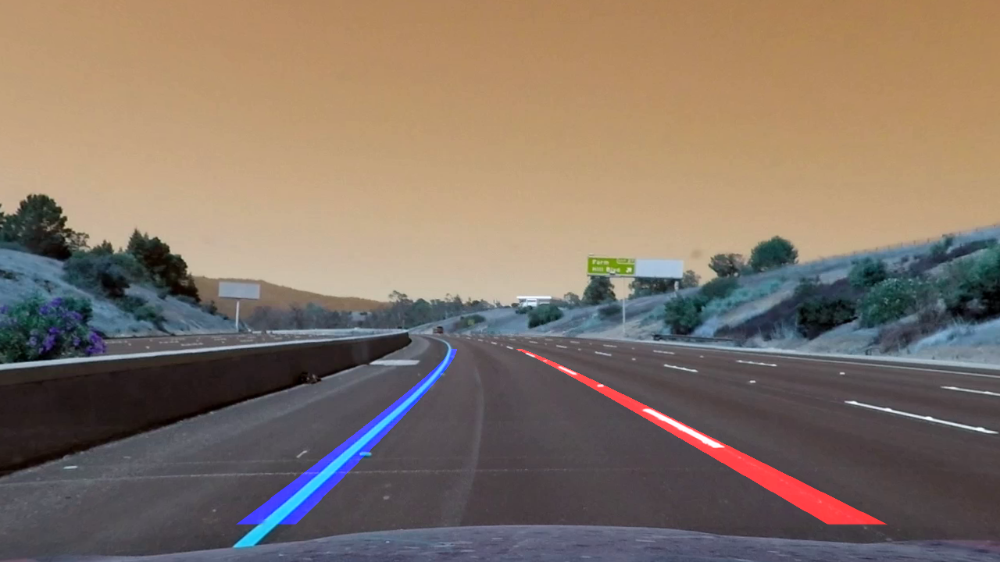

























t:   8%|▊         | 27/338 [12:39<12:32,  2.42s/it, now=None]



t:  30%|███       | 103/338 [04:52<05:14,  1.34s/it, now=None]





t:  10%|█         | 34/338 [13:51<05:08,  1.01s/it, now=None]

t:  30%|███       | 103/338 [18:00<05:30,  1.40s/it, now=None]




t:  10%|█         | 35/338 [02:41<04:56,  1.02it/s, now=None]























t:   8%|▊         | 27/338 [12:39<12:32,  2.42s/it, now=None]



t:  30%|███       | 103/338 [04:52<05:14,  1.34s/it, now=None]





t:  10%|█         | 34/338 [13:51<05:08,  1.01s/it, now=None]

t:  30%|███       | 103/338 [18:00<05:30,  1.40s/it, now=None]




t:  10%|█         | 35/338 [02:41<04:56,  1.02it/s, now=None]

no detection
Moviepy - Building video presentation.mp4.
Moviepy - Writing video presentation.mp4










t:   0%|          | 0/338 [00:00<?, ?it/s, now=None]

463
2


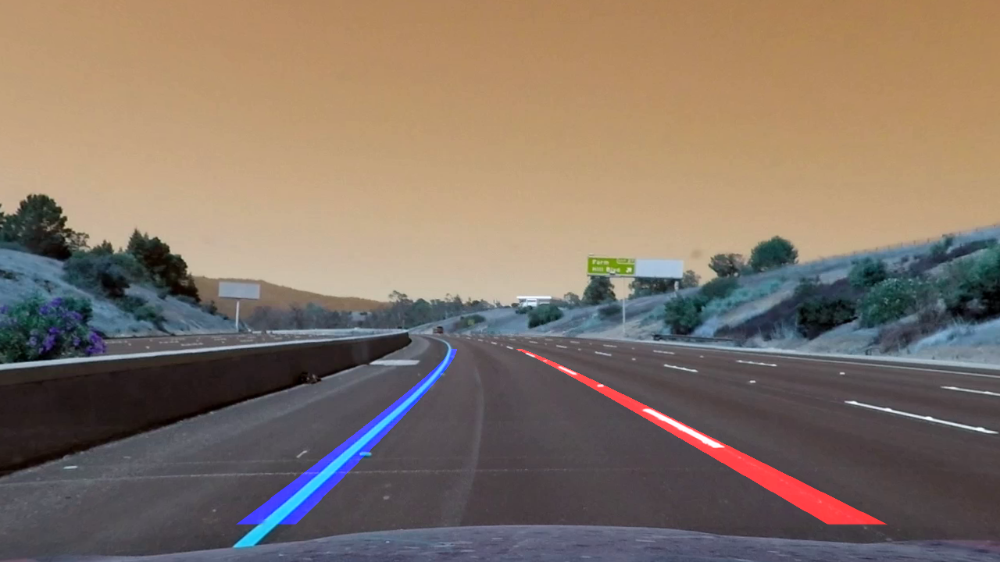








t:   1%|          | 2/338 [00:01<04:54,  1.14it/s, now=None]

no detection
463
2


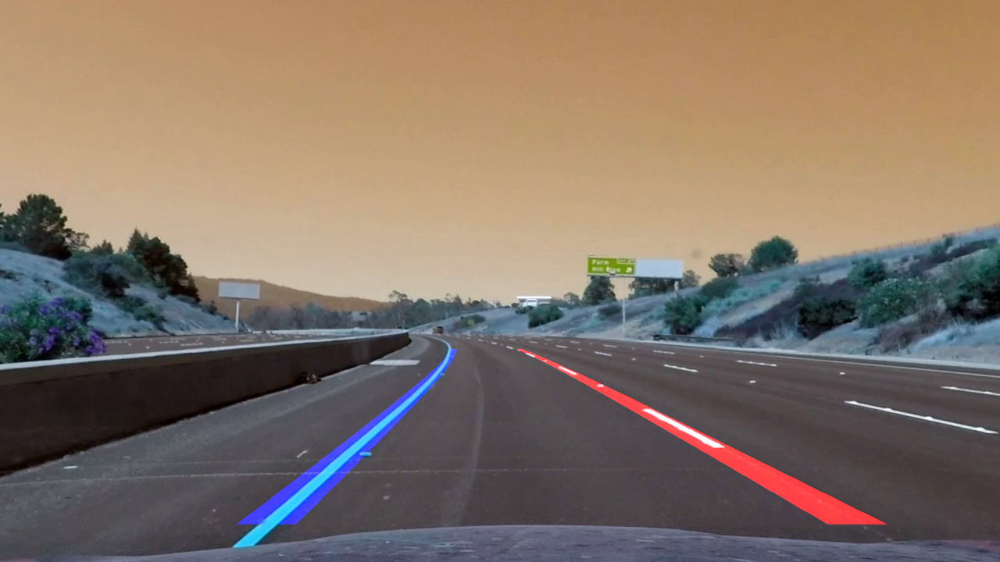








t:   1%|          | 3/338 [00:03<06:15,  1.12s/it, now=None]

no detection
465
2


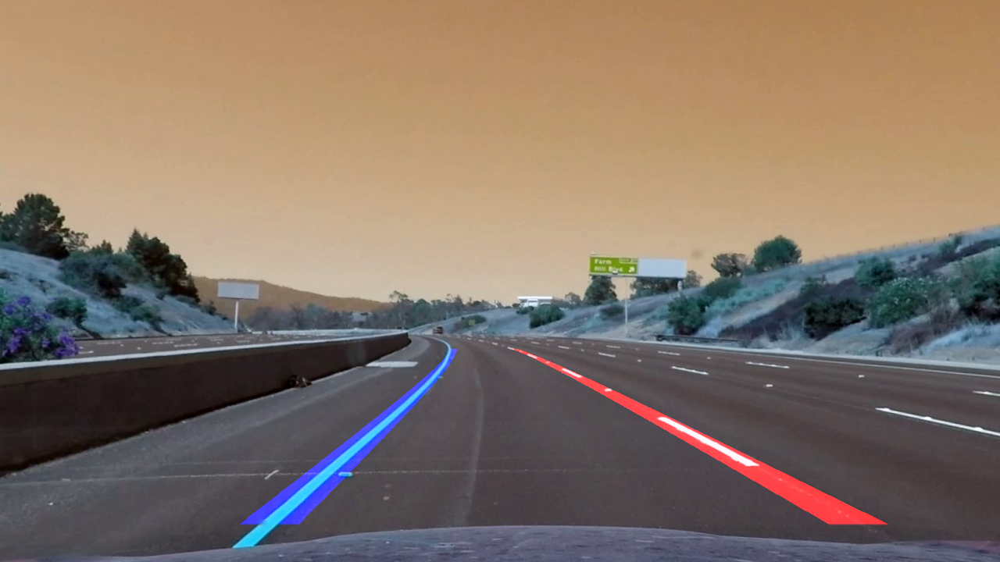








t:   1%|          | 4/338 [00:04<06:28,  1.16s/it, now=None]

no detection
466
2


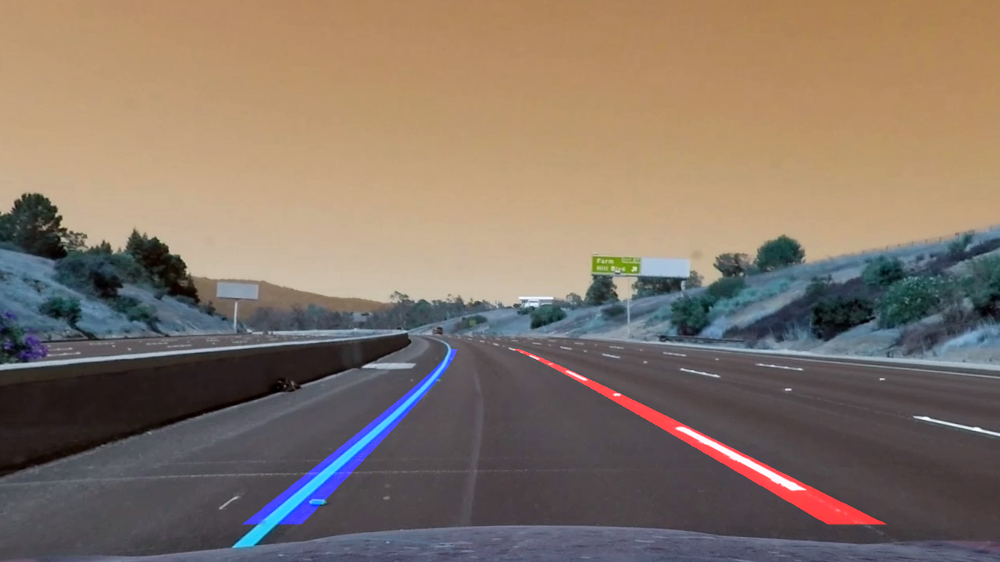








t:   1%|▏         | 5/338 [00:05<06:39,  1.20s/it, now=None]

no detection
457
2


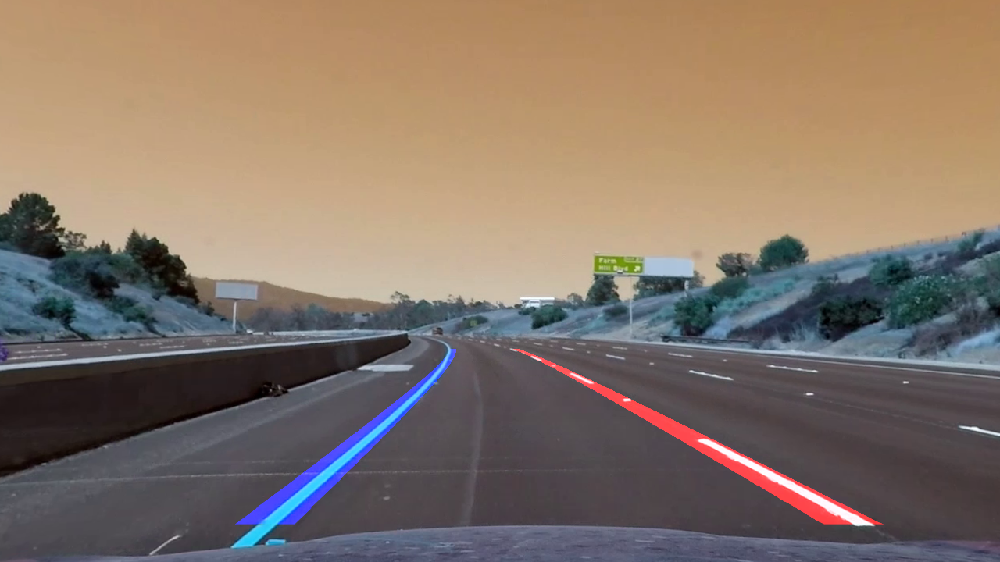








t:   2%|▏         | 6/338 [00:06<06:36,  1.19s/it, now=None]

no detection
457
2


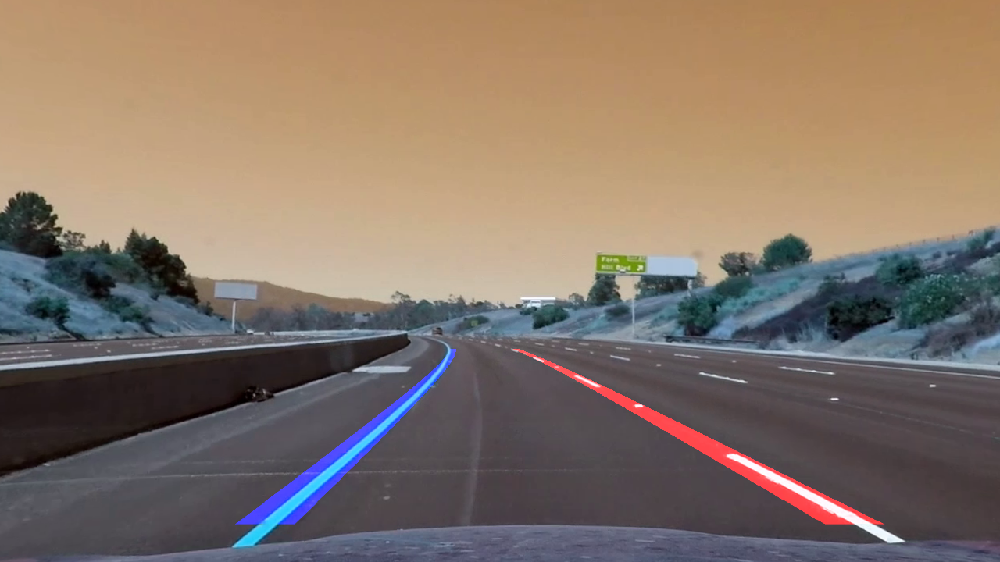








t:   2%|▏         | 7/338 [00:08<06:41,  1.21s/it, now=None]

no detection
465
2


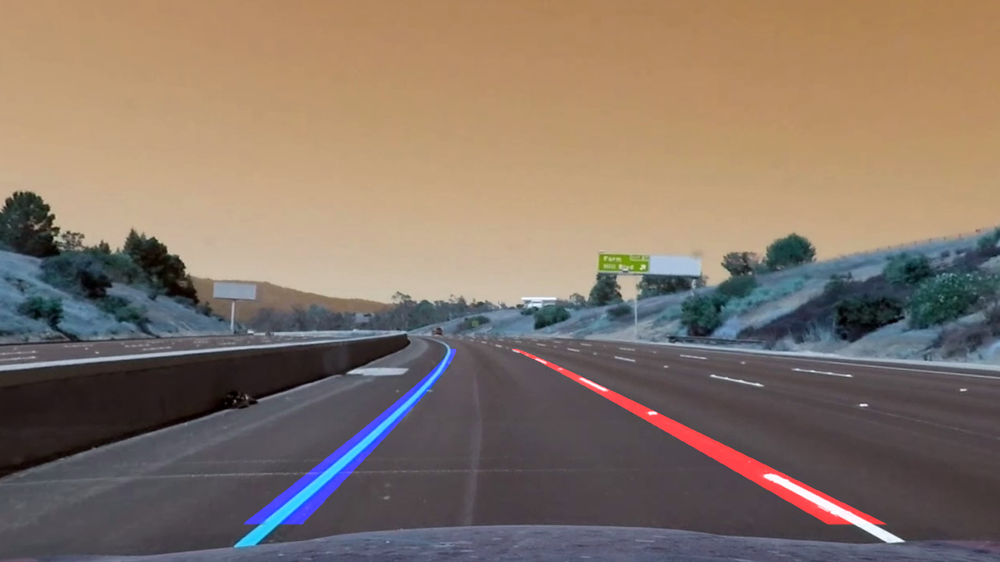








t:   2%|▏         | 8/338 [00:09<06:54,  1.26s/it, now=None]

no detection
465
2


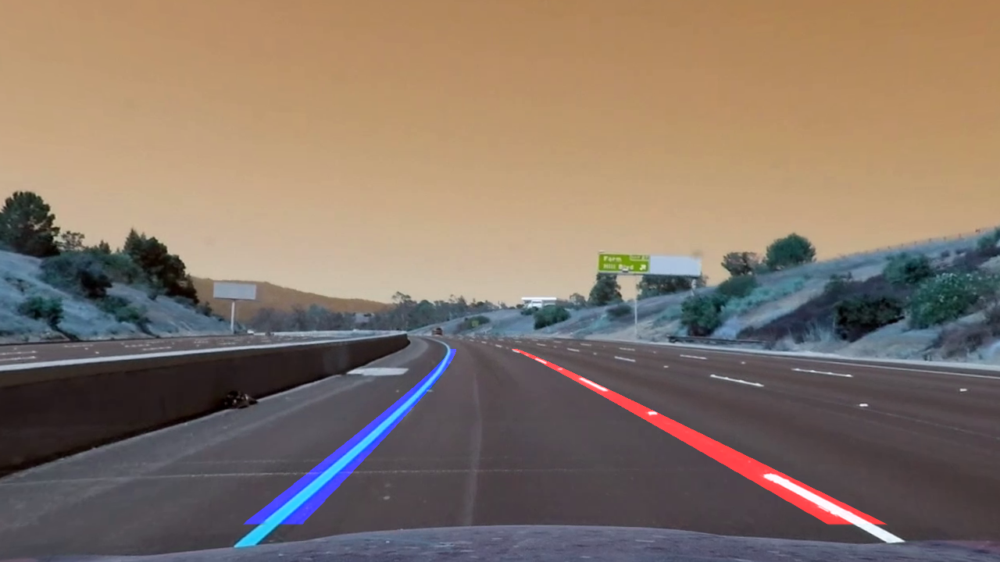








t:   3%|▎         | 9/338 [00:10<07:00,  1.28s/it, now=None]

no detection
465
2


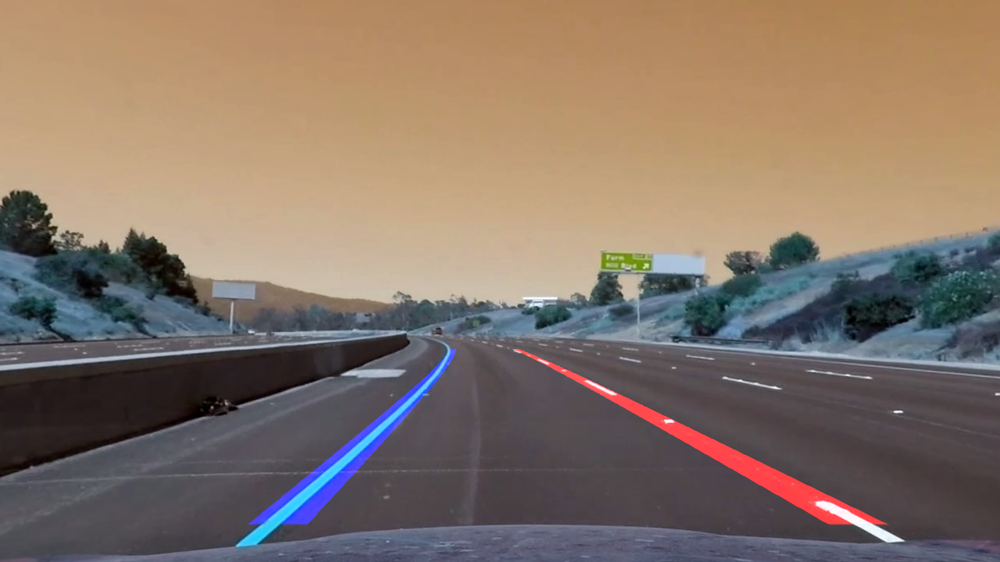








t:   3%|▎         | 10/338 [00:12<07:36,  1.39s/it, now=None]

no detection
464
2


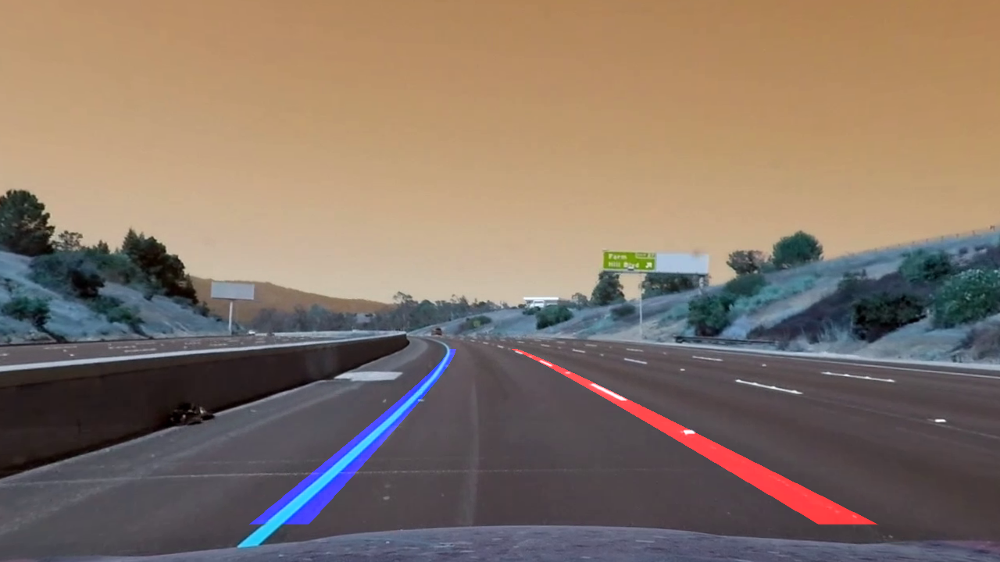








t:   3%|▎         | 11/338 [00:14<08:09,  1.50s/it, now=None]

no detection
459
2


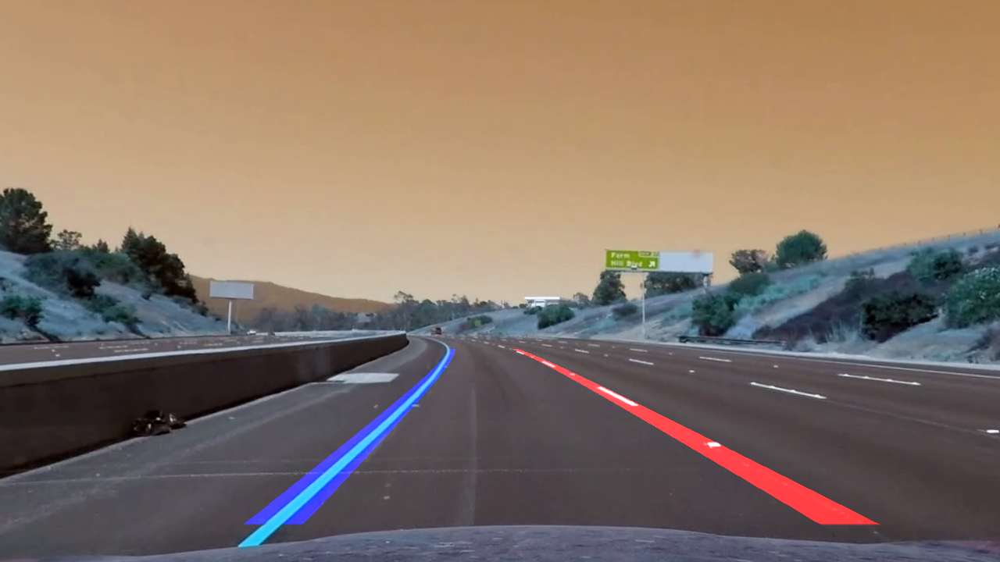








t:   4%|▎         | 12/338 [00:15<08:29,  1.56s/it, now=None]

no detection
459
2


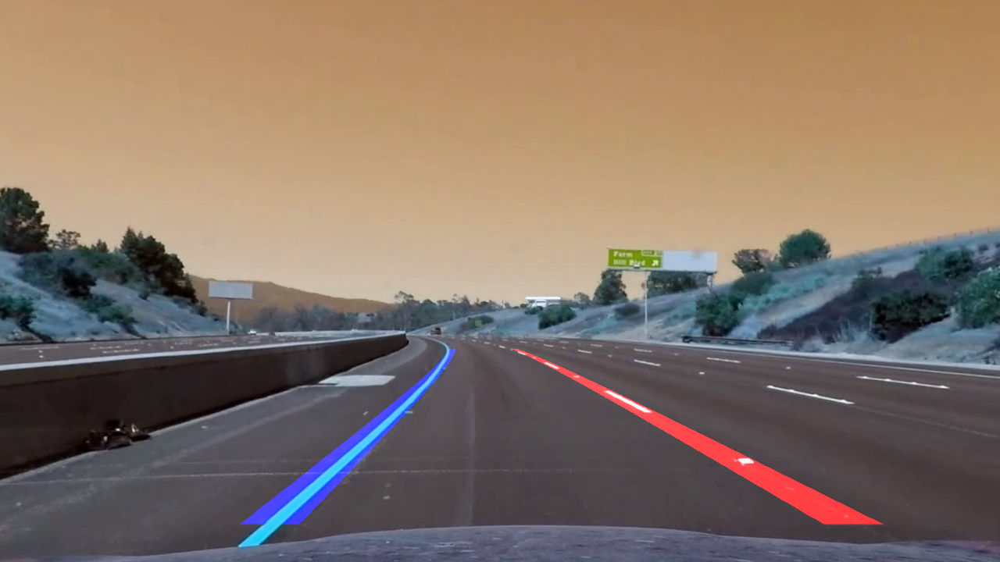








t:   4%|▍         | 13/338 [00:17<08:40,  1.60s/it, now=None]

no detection
462
2


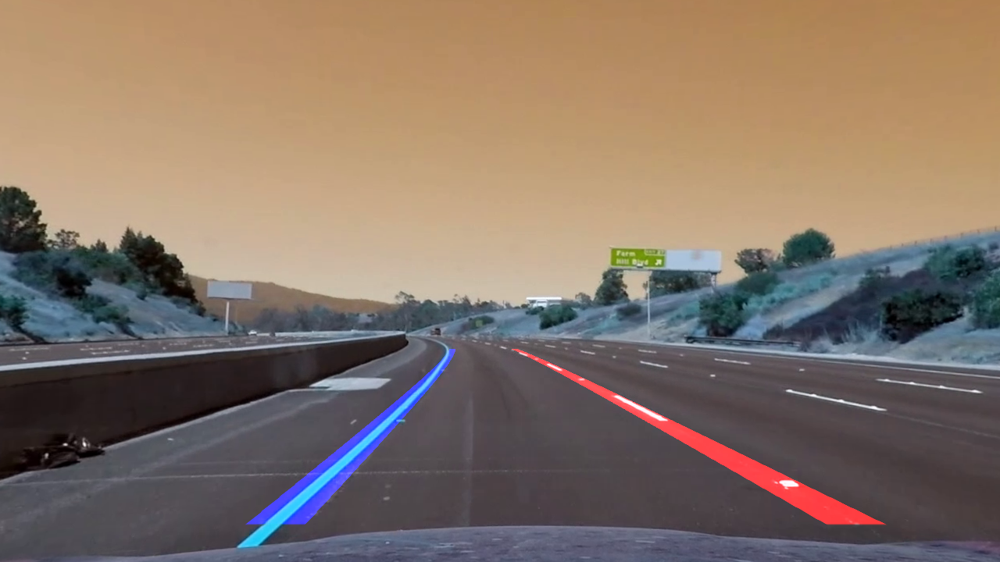








t:   4%|▍         | 14/338 [00:19<08:47,  1.63s/it, now=None]

no detection
462
2


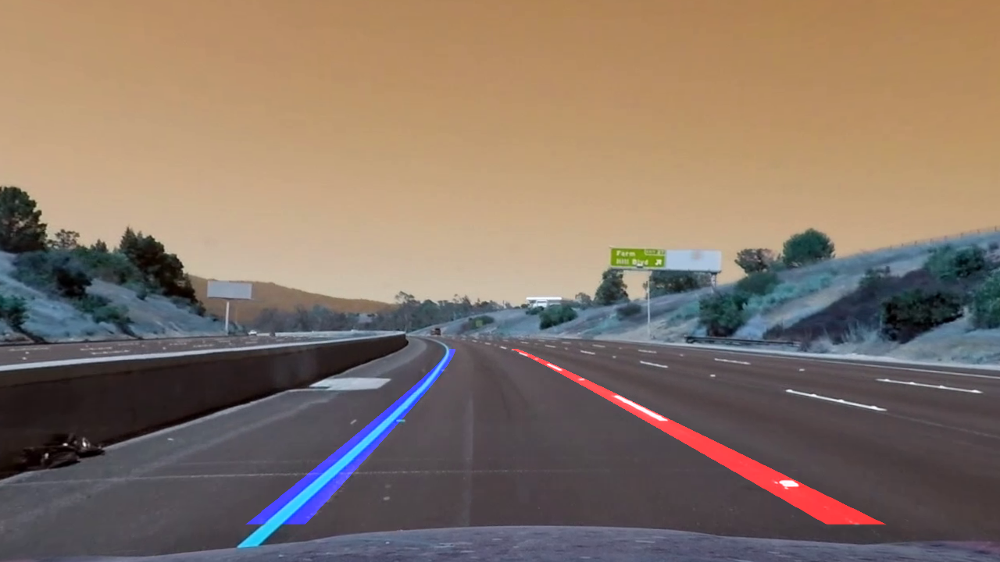








t:   4%|▍         | 15/338 [00:20<08:48,  1.64s/it, now=None]

no detection
458
2


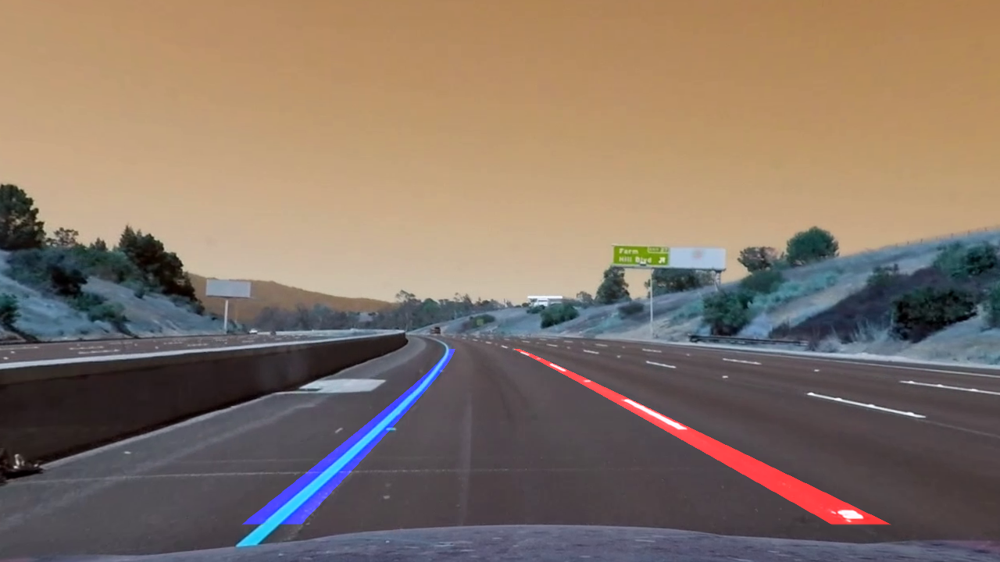








t:   5%|▍         | 16/338 [00:22<08:45,  1.63s/it, now=None]

no detection
459
2


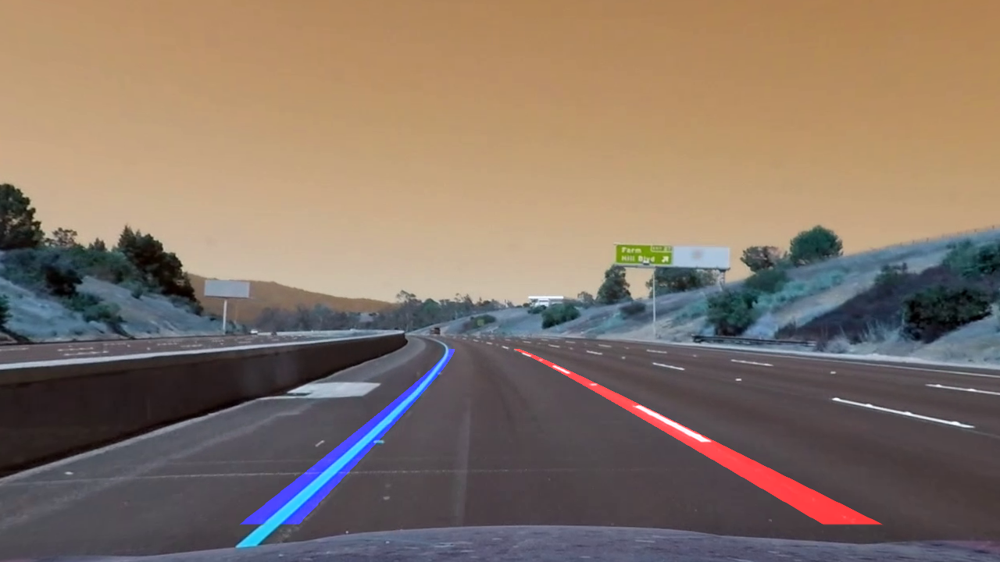








t:   5%|▌         | 17/338 [00:24<08:46,  1.64s/it, now=None]

no detection
458
2


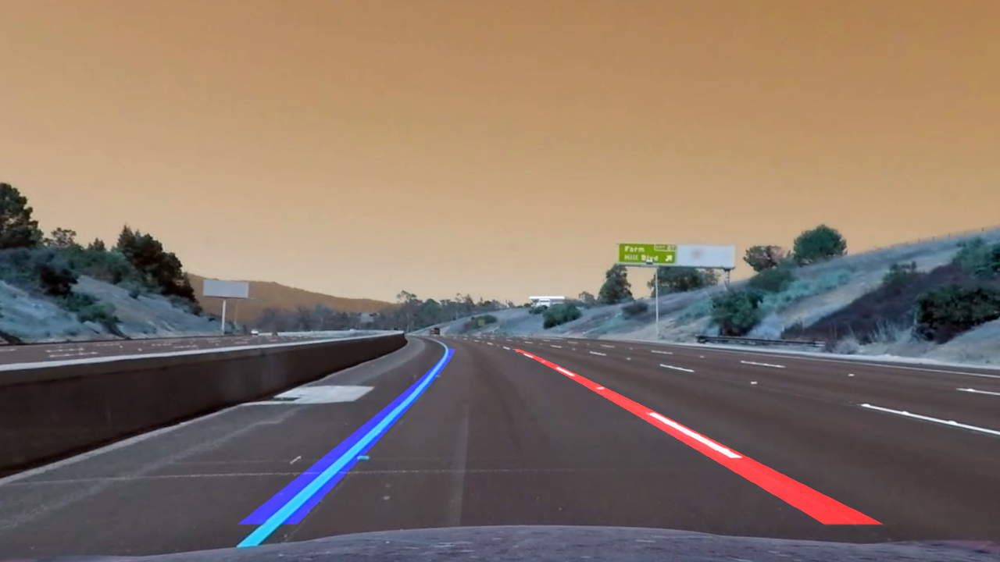








t:   5%|▌         | 18/338 [00:25<08:49,  1.65s/it, now=None]

no detection
457
2


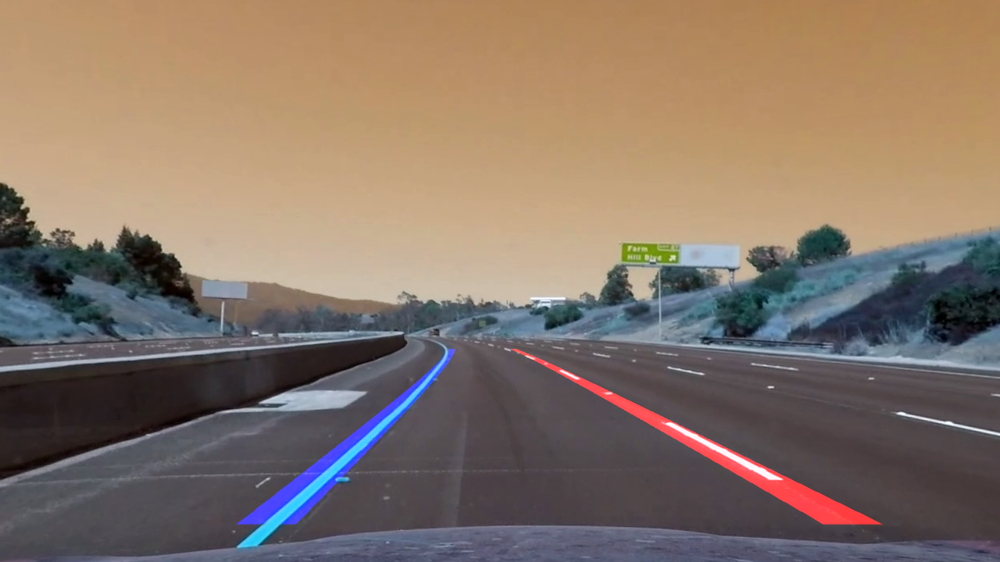








t:   6%|▌         | 19/338 [00:27<08:47,  1.65s/it, now=None]

no detection
457
2


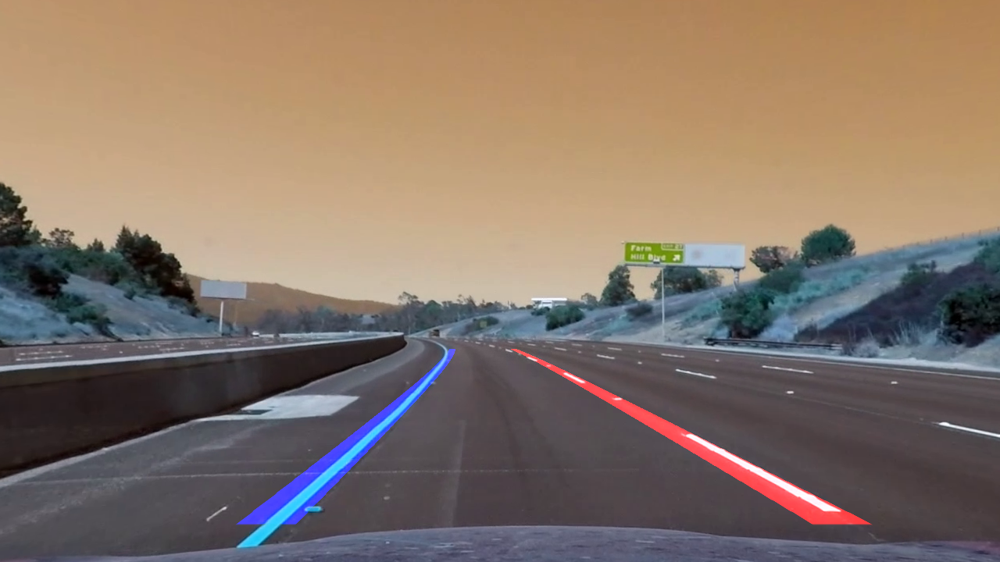








t:   6%|▌         | 20/338 [00:29<08:45,  1.65s/it, now=None]

no detection
457
2


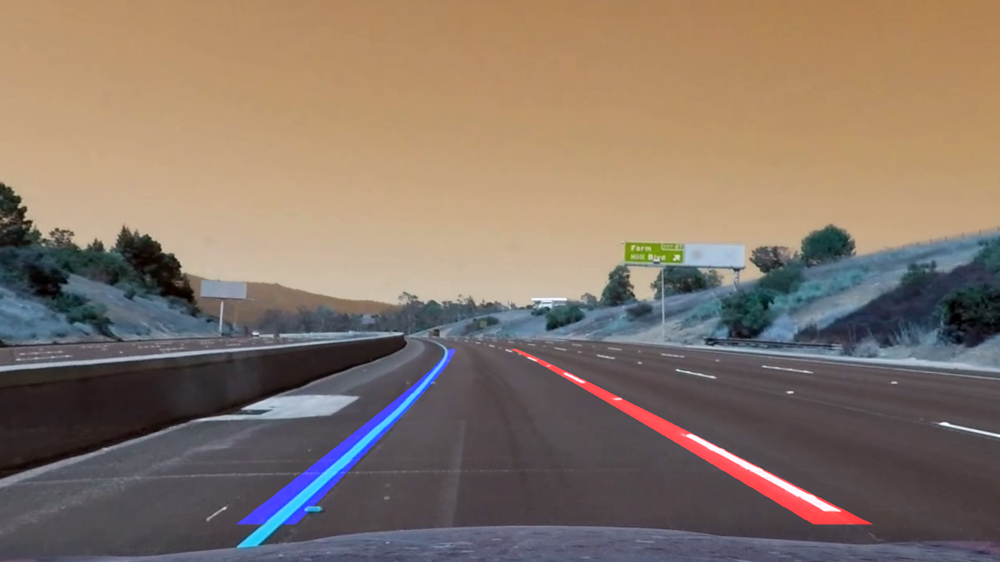








t:   6%|▌         | 21/338 [00:31<08:56,  1.69s/it, now=None]

no detection
457
2


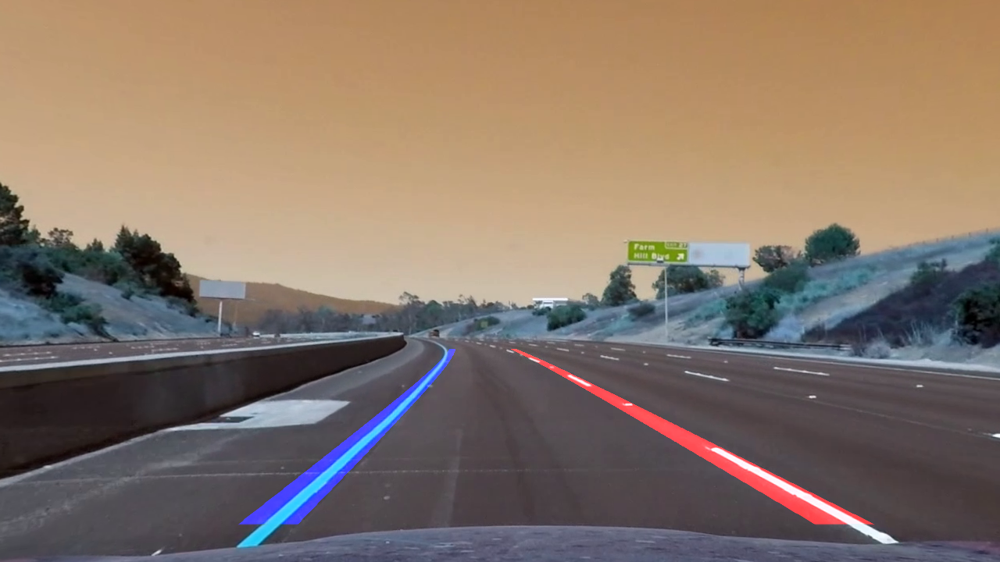








t:   7%|▋         | 22/338 [00:32<08:59,  1.71s/it, now=None]

no detection
457
2


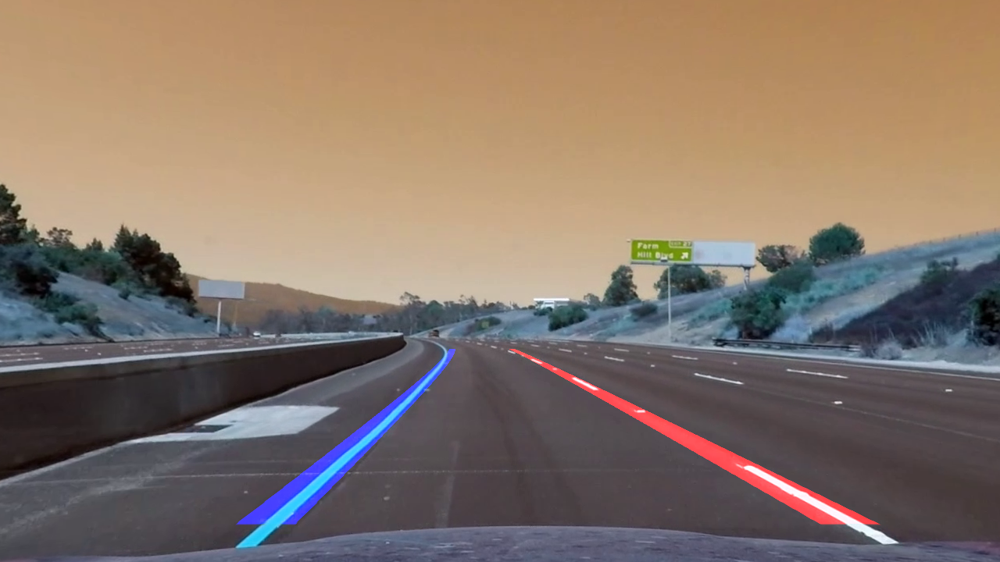








t:   7%|▋         | 23/338 [00:34<09:00,  1.72s/it, now=None]

no detection
456
2


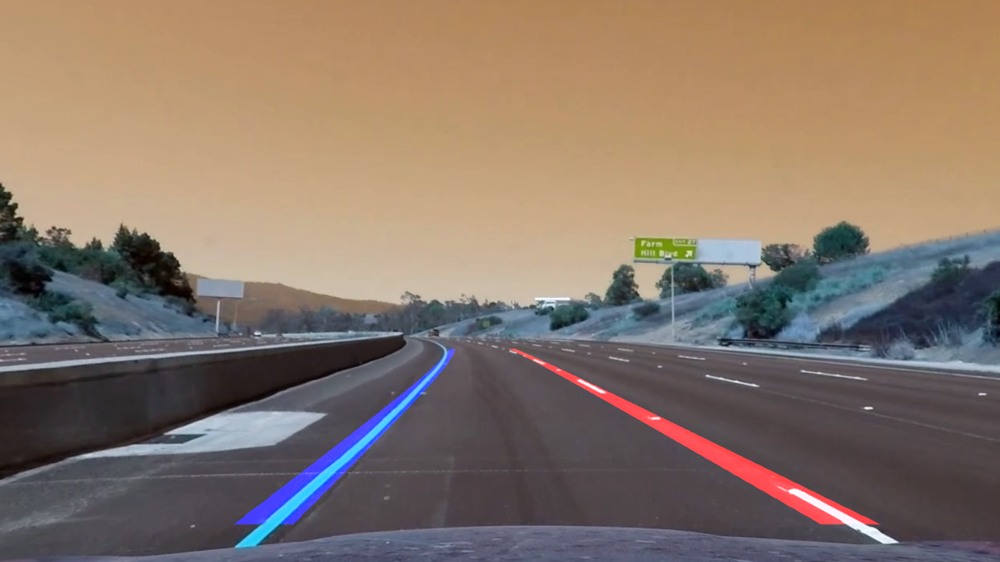








t:   7%|▋         | 24/338 [00:36<08:51,  1.69s/it, now=None]

no detection
454
2


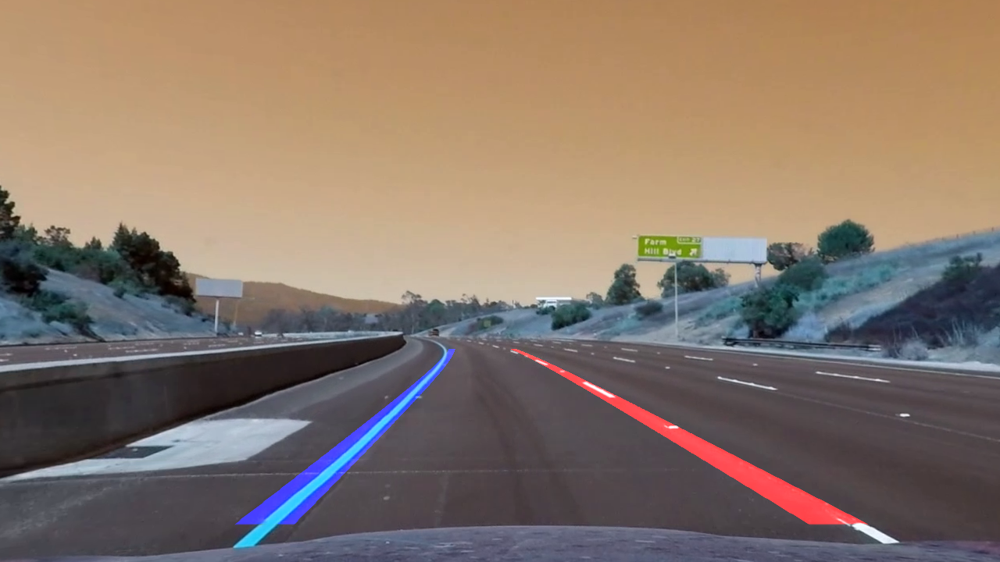








t:   7%|▋         | 25/338 [00:37<08:39,  1.66s/it, now=None]

no detection
454
2


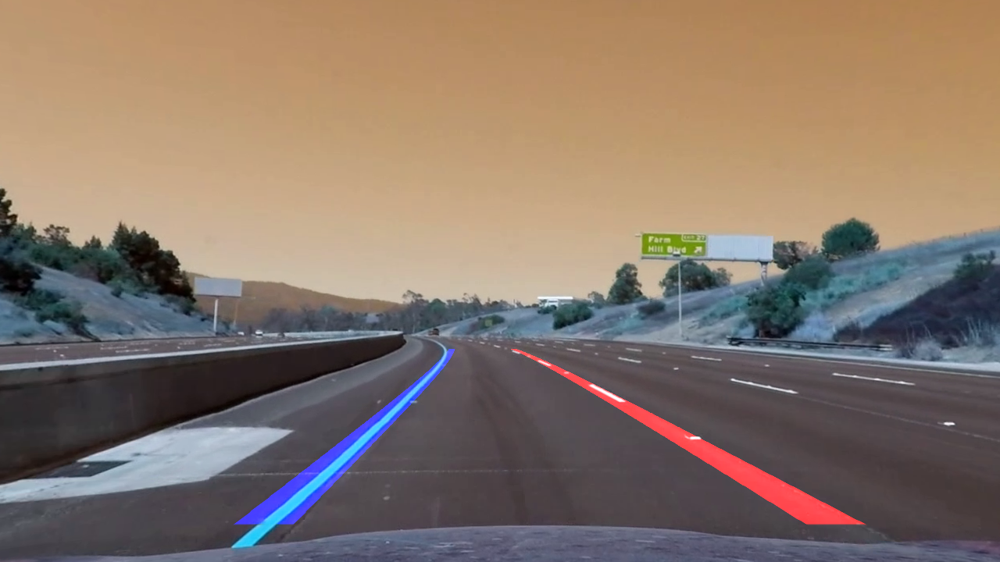








t:   8%|▊         | 26/338 [00:39<08:29,  1.63s/it, now=None]

no detection
454
2


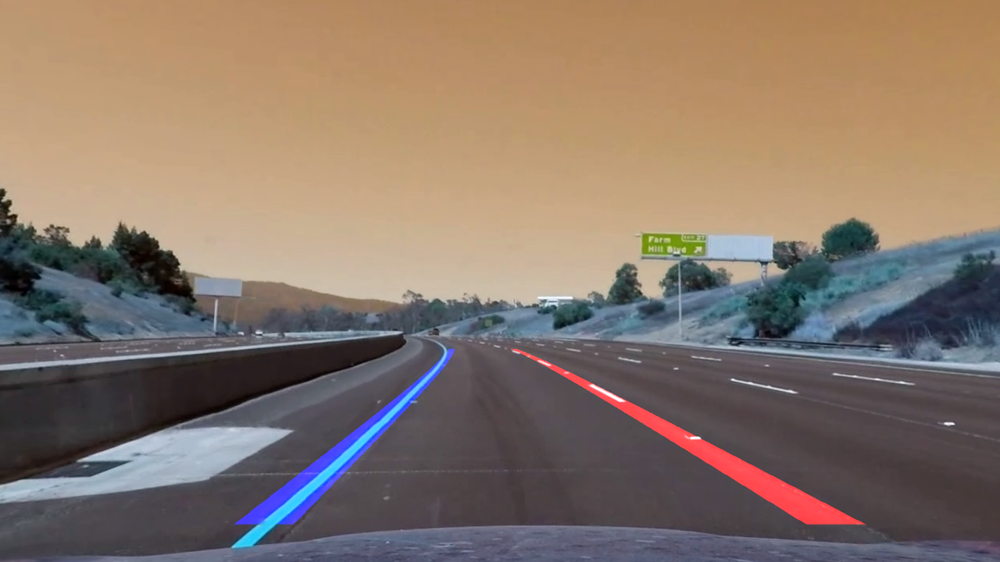








t:   8%|▊         | 27/338 [00:40<08:32,  1.65s/it, now=None]

no detection
452
2


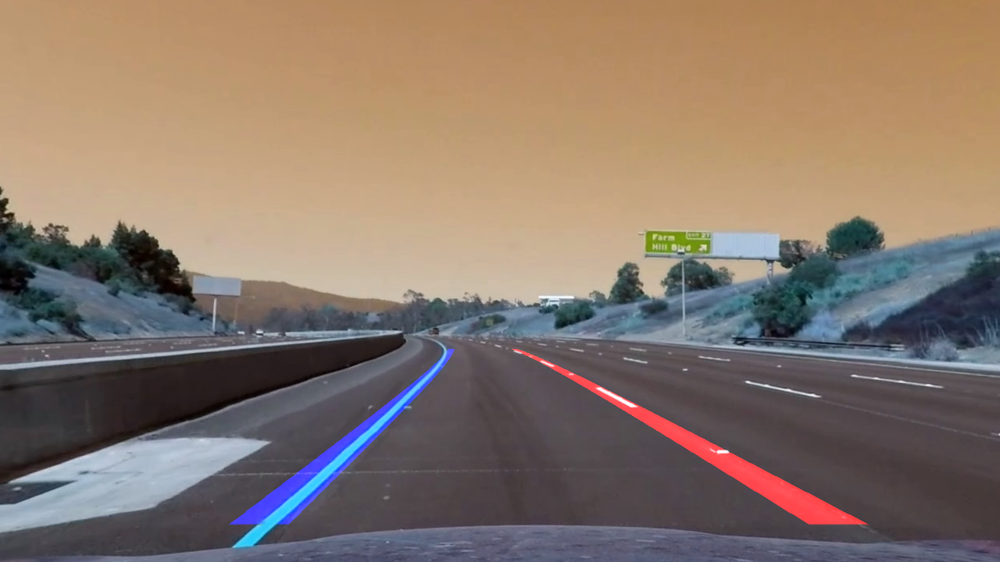








t:   8%|▊         | 28/338 [00:42<08:26,  1.64s/it, now=None]

no detection
449
2


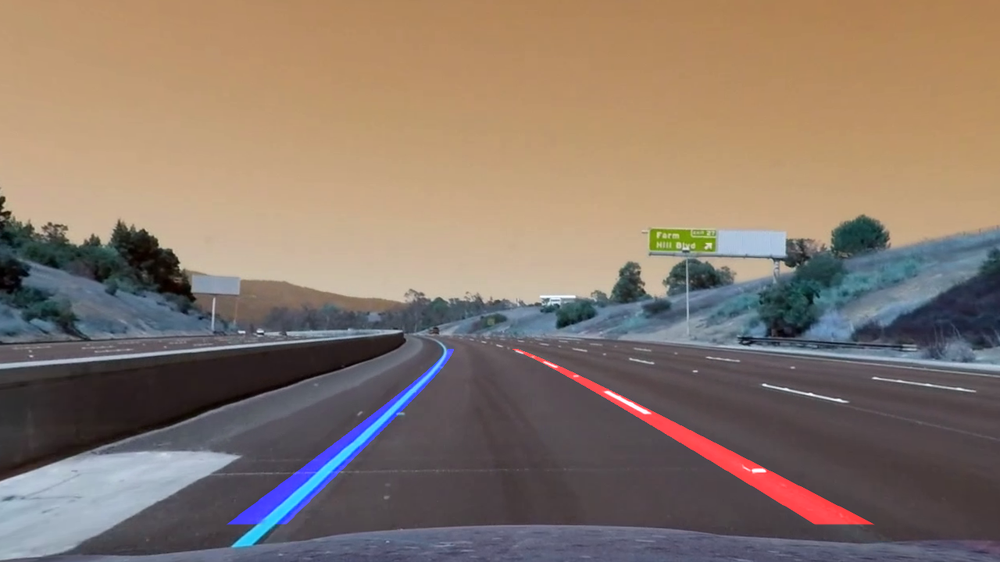








t:   9%|▊         | 29/338 [00:44<08:19,  1.62s/it, now=None]

no detection
448
2


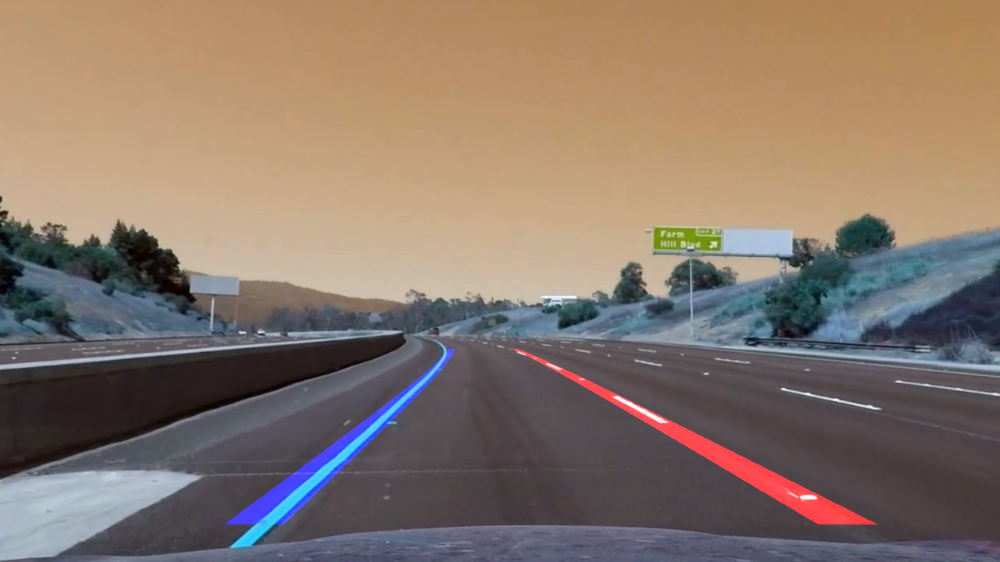








t:   9%|▉         | 30/338 [00:45<08:26,  1.64s/it, now=None]

no detection
449
2


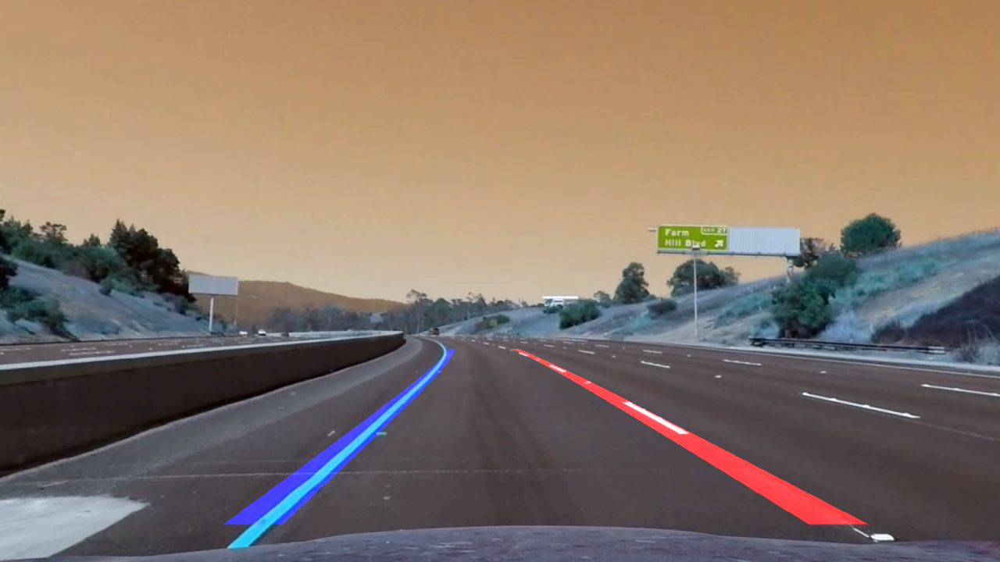








t:   9%|▉         | 31/338 [00:47<08:36,  1.68s/it, now=None]

no detection
447
2


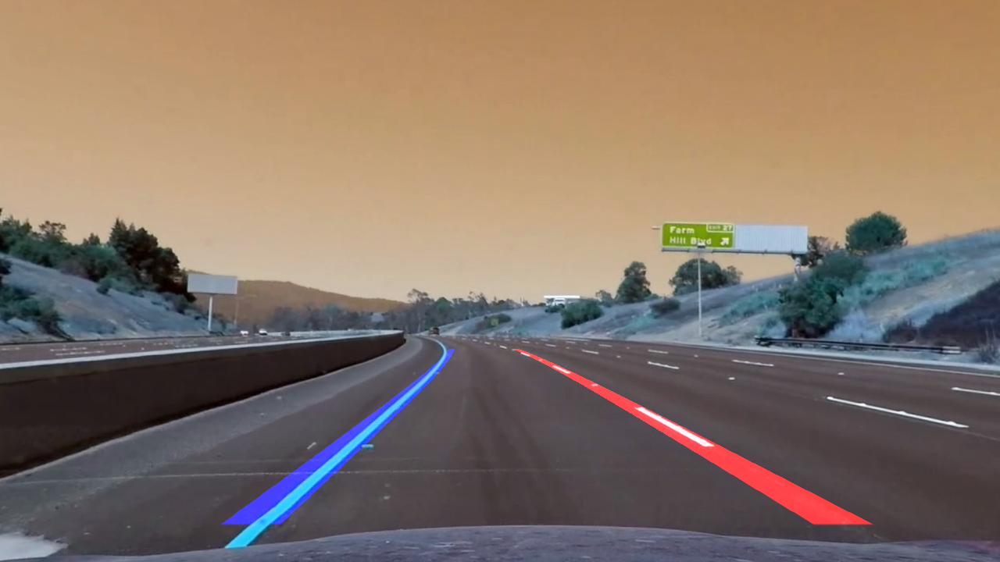








t:   9%|▉         | 32/338 [00:49<08:41,  1.70s/it, now=None]

no detection
447
2


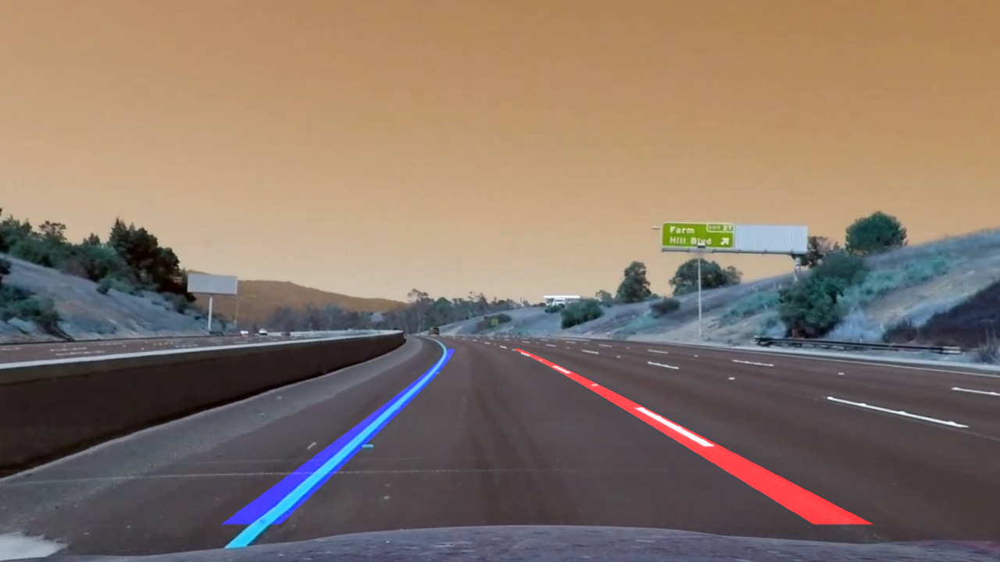








t:  10%|▉         | 33/338 [00:51<08:42,  1.71s/it, now=None]

no detection
446
2


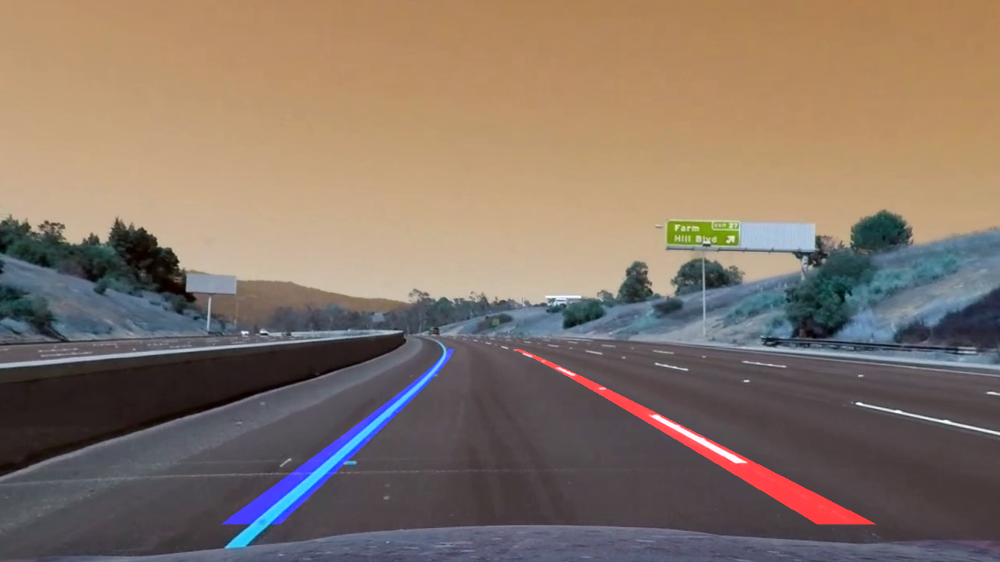








t:  10%|█         | 34/338 [00:52<08:34,  1.69s/it, now=None]

no detection
444
2


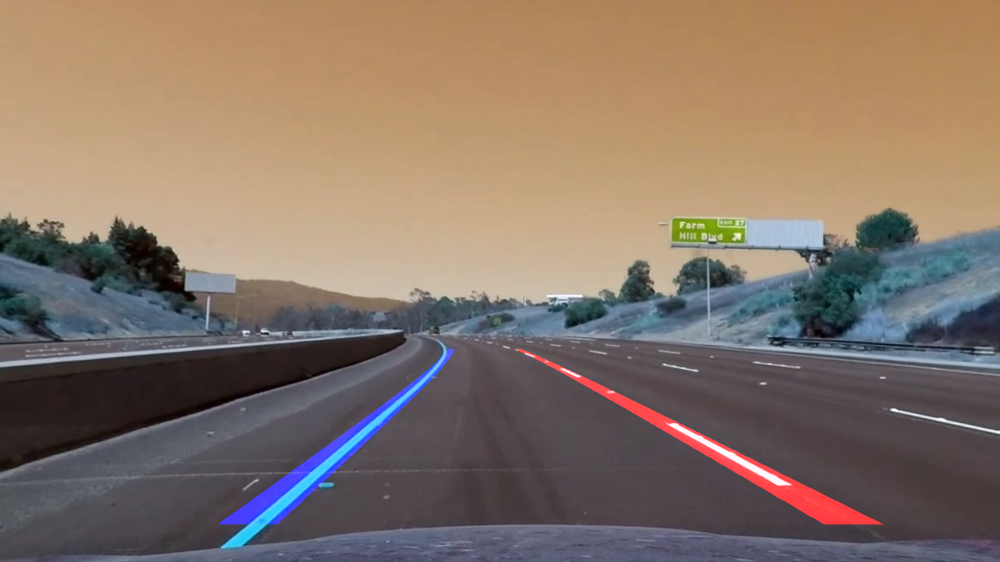








t:  10%|█         | 35/338 [00:54<08:32,  1.69s/it, now=None]

no detection
444
2


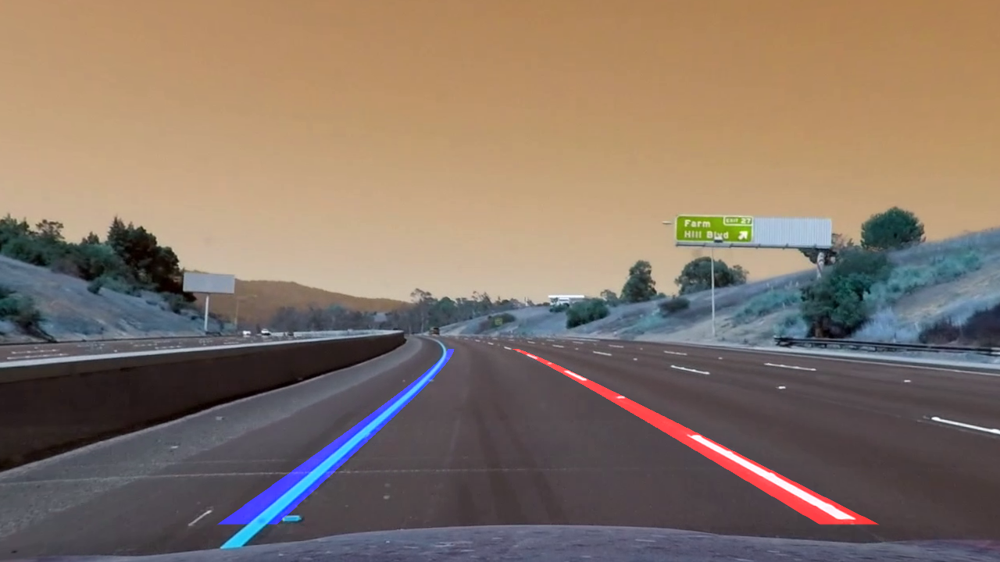








t:  11%|█         | 36/338 [00:56<08:34,  1.70s/it, now=None]

no detection
444
2


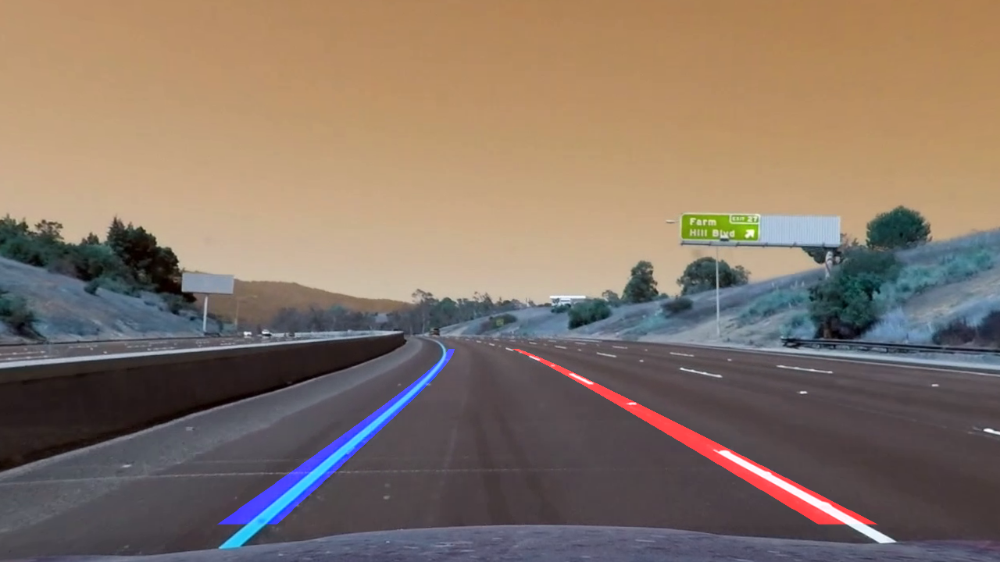








t:  11%|█         | 37/338 [00:57<08:34,  1.71s/it, now=None]

no detection
448
2


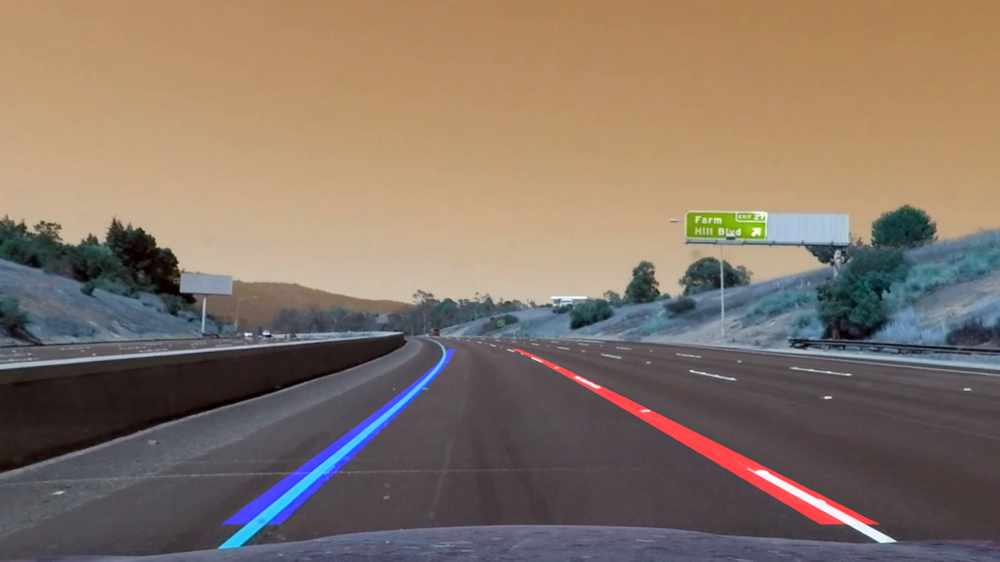








t:  11%|█         | 38/338 [00:59<08:35,  1.72s/it, now=None]

no detection
448
2


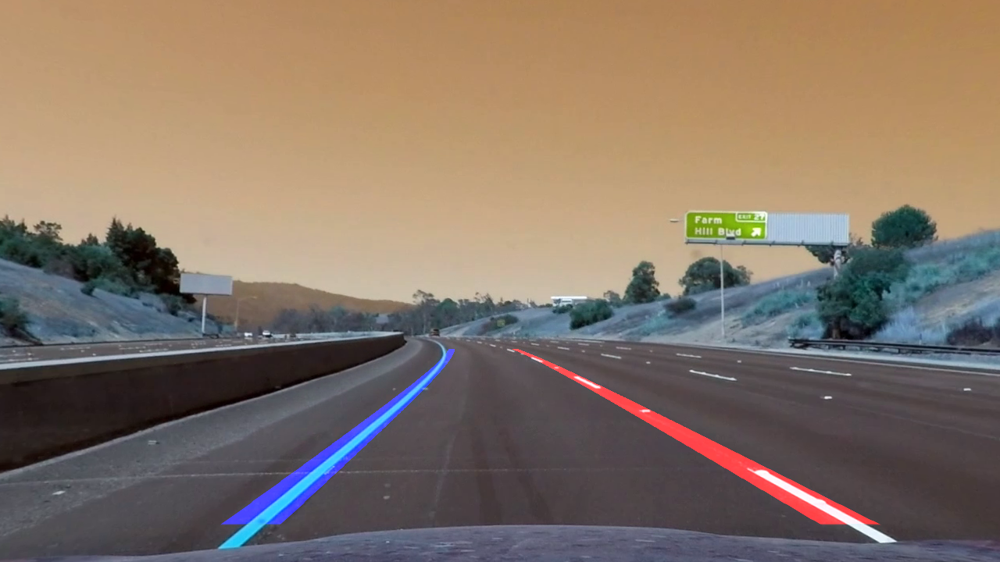








t:  12%|█▏        | 39/338 [01:01<08:48,  1.77s/it, now=None]

no detection
453
2


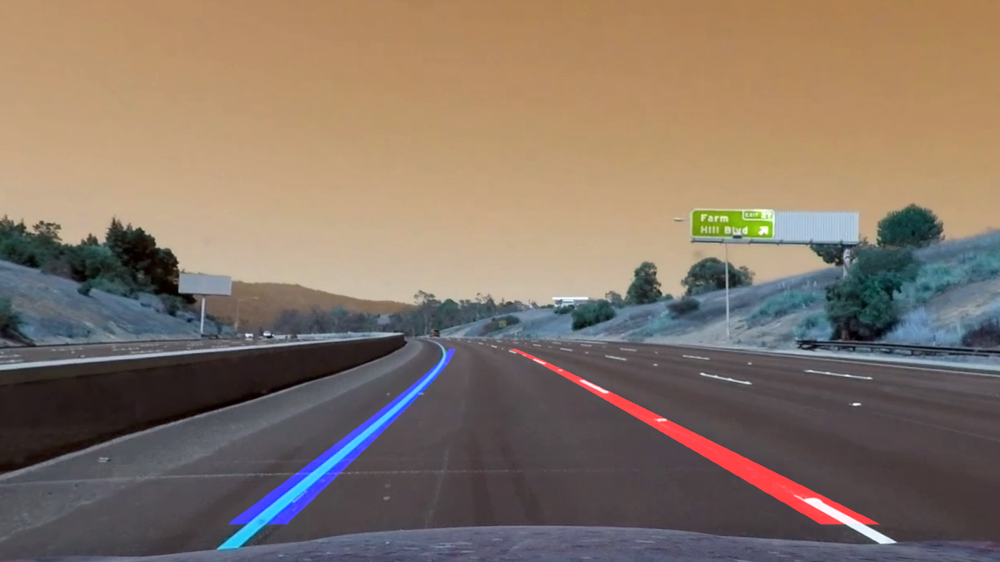








t:  12%|█▏        | 40/338 [01:03<08:40,  1.75s/it, now=None]

no detection
451
2


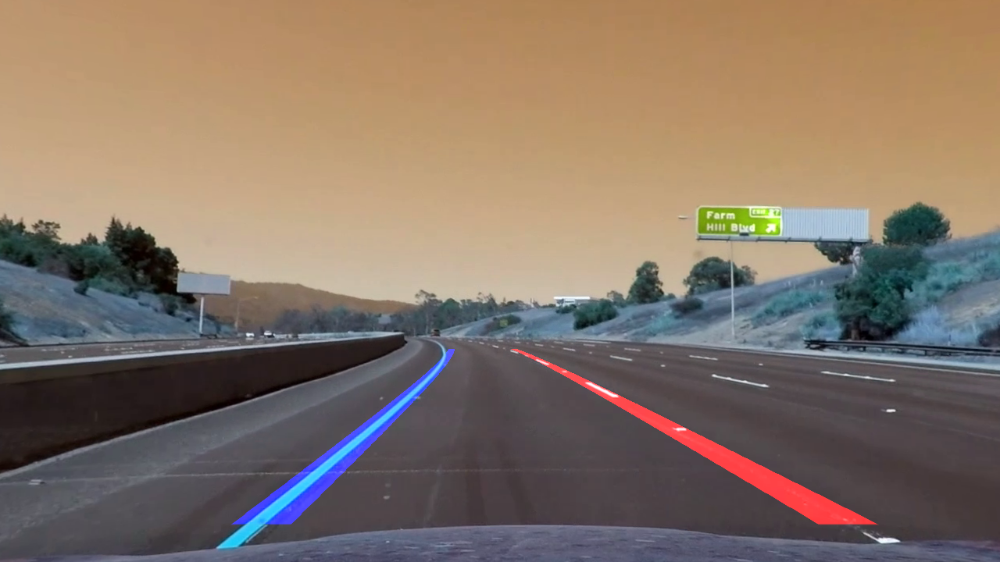








t:  12%|█▏        | 41/338 [01:04<08:36,  1.74s/it, now=None]

no detection
452
2


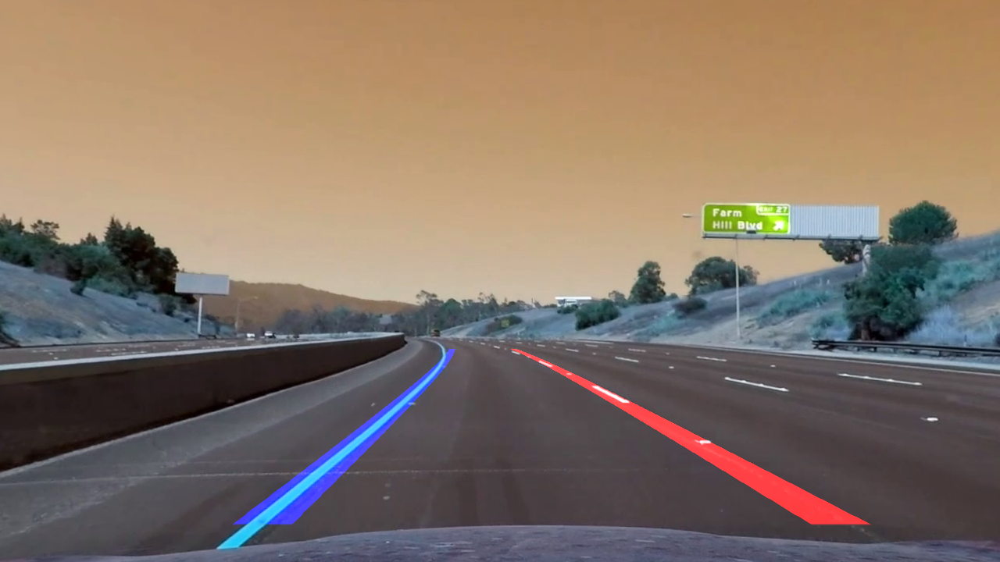








t:  12%|█▏        | 42/338 [01:06<08:32,  1.73s/it, now=None]

no detection
452
2


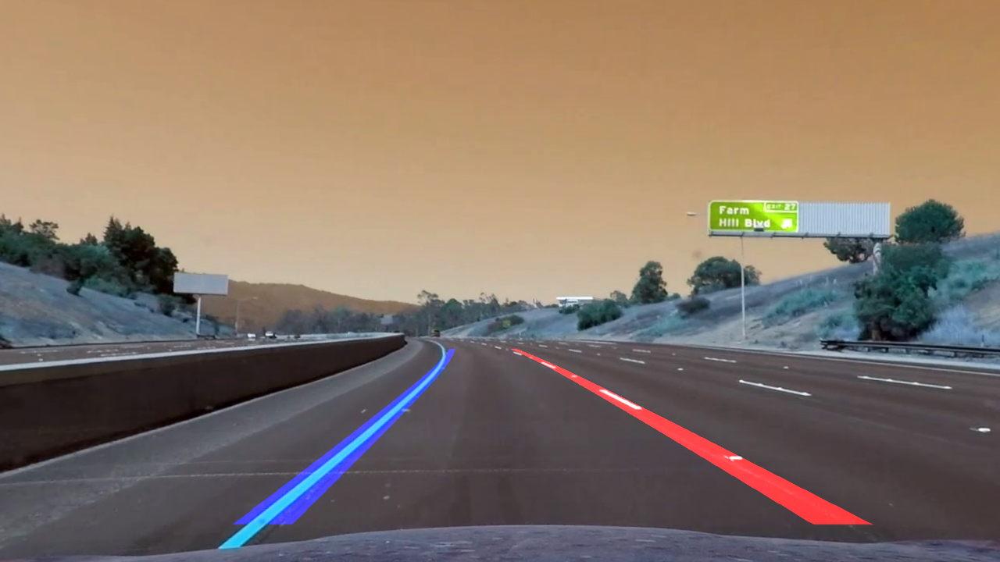








t:  13%|█▎        | 43/338 [01:08<08:19,  1.69s/it, now=None]

no detection
453
2


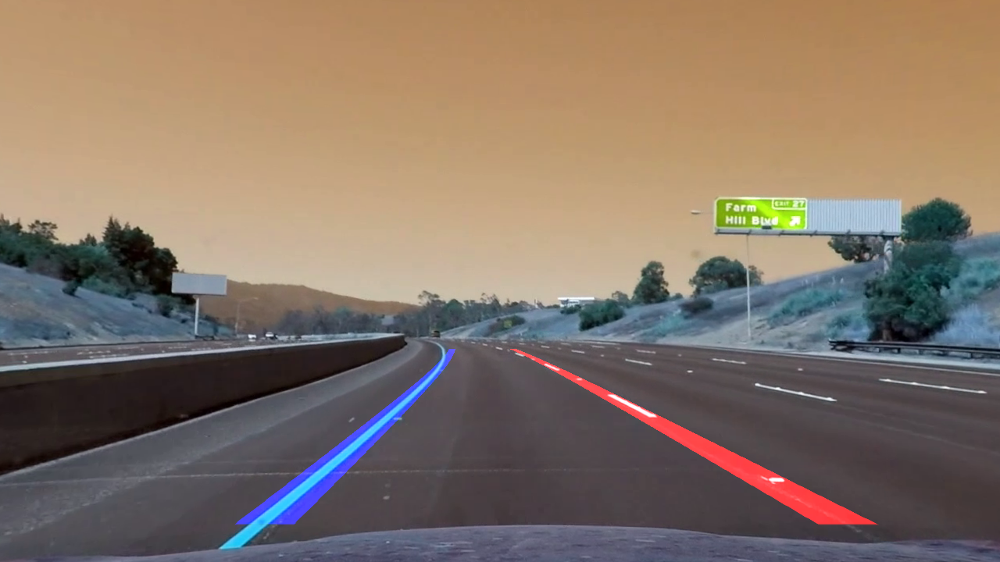








t:  13%|█▎        | 44/338 [01:10<08:38,  1.76s/it, now=None]

no detection
453
2


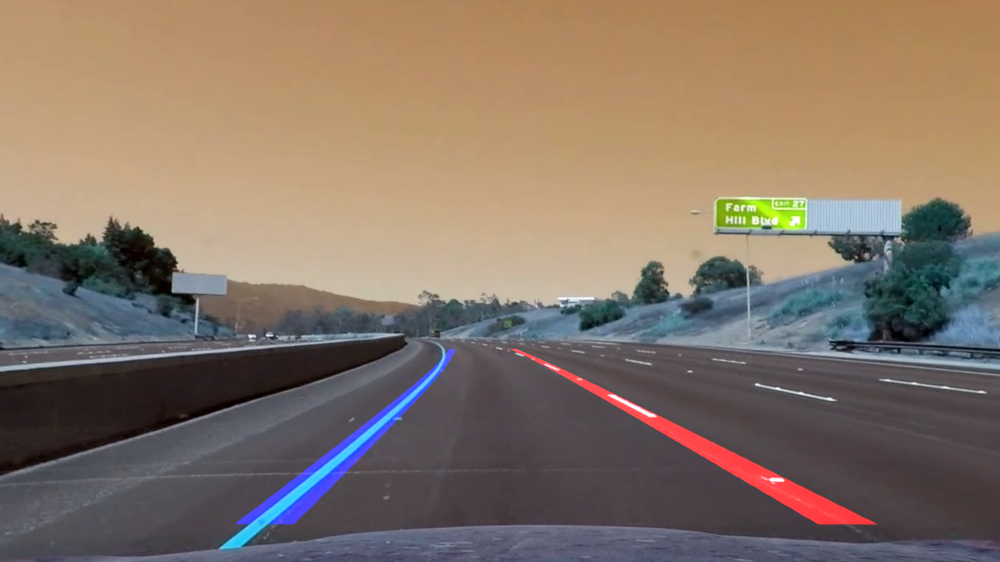








t:  13%|█▎        | 45/338 [01:11<08:25,  1.73s/it, now=None]

no detection
456
2


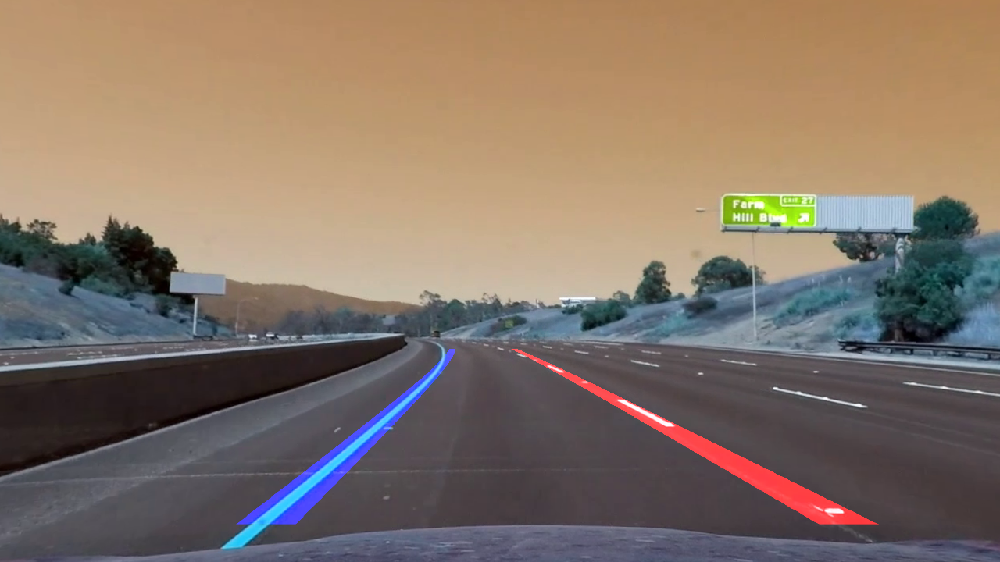








t:  14%|█▎        | 46/338 [01:13<08:13,  1.69s/it, now=None]

no detection
458
2


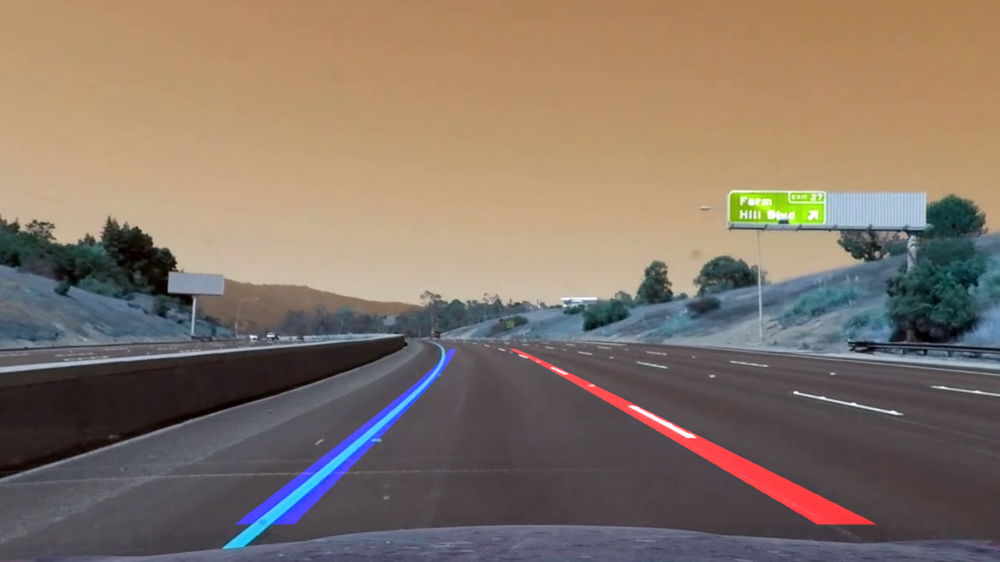








t:  14%|█▍        | 47/338 [01:15<08:01,  1.66s/it, now=None]

no detection
460
2


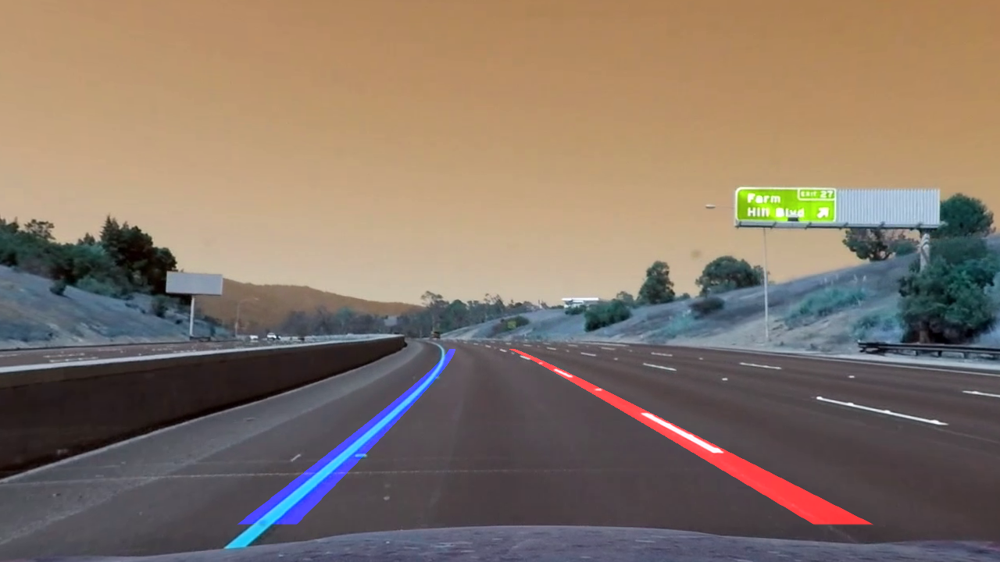








t:  14%|█▍        | 48/338 [01:16<08:00,  1.66s/it, now=None]

no detection
458
2


In [ ]:
from sort import *
mot_tracker = Sort()
final_video = 'presentation.mp4'
input_vid = '/content/gdrive/MyDrive/CV Project Data/smaller_video - Made with Clipchamp.mp4'
counter = 0
clip1 = VideoFileClip(input_vid)
video_clip = clip1.fl_image(lambda image:process_image(image, counter=counter+1))
counter+=1
video_clip.write_videofile(final_video, audio = False)

In [ ]:
!pip install moviepy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
